In [1]:
import numpy as np
np.set_printoptions(precision=5)

from scipy.linalg import block_diag
from scipy.integrate import ode

import nengo
from nengo.utils.matplotlib import rasterplot
from nengo.params import Default, NumberParam
from nengo.dists import Uniform
from nengo.neurons import *
from nengo.builder.neurons import *
from nengo.dists import Uniform
from nengo.solvers import LstsqL2, NoSolver
from nengo.base import ObjView
from nengo.builder import Builder, Operator, Signal
from nengo.exceptions import BuildError
from nengo.builder.connection import build_decoders, BuiltConnection
from nengo.utils.builder import full_transform

from nengolib.signal import s, z, nrmse, LinearSystem
from nengolib import Lowpass, DoubleExp

import matplotlib.pyplot as plt

import seaborn as sns
sns.set(context='poster', style='whitegrid')
%matplotlib inline

import time
import warnings

import neuron
neuron.h.load_file('./NEURON/durstewitz/durstewitz.hoc')
neuron.h.load_file('stdrun.hoc')

	1 


1.0

## Neuron Types

In [2]:
class AdaptiveLIFT(LIFRate):
    
    '''
    Aaron Voelker
    https://github.com/nengo/nengo/issues/1423
    '''
    
    probeable = ('spikes', 'voltage', 'refractory_time', 'threshold')

    min_voltage = NumberParam('min_voltage', high=0)
    tau_adapt = NumberParam('tau_adapt', low=0)
    inc_adapt = NumberParam('inc_adapt', low=0)

    def __init__(self, tau_rc=0.02, tau_ref=0.002, min_voltage=0,
                 amplitude=1, tau_adapt=0.1, inc_adapt=0.05):
        super(AdaptiveLIFT, self).__init__(
            tau_rc=tau_rc, tau_ref=tau_ref, amplitude=amplitude)
        self.min_voltage = min_voltage
        self.tau_adapt = tau_adapt
        self.inc_adapt = inc_adapt
        
    def rates(self, x, gain, bias):
        """Estimates steady-state firing rate given gain and bias."""
        J = self.current(x, gain, bias)
        voltage = np.zeros_like(gain)
        refractory_time = np.zeros_like(gain)
        threshold = np.ones_like(gain)

        return settled_firingrate(
            self.step_math, J, [voltage, refractory_time, threshold],
            dt=0.001, settle_time=0.3, sim_time=1.0)
    
    def gain_bias(self, max_rates, intercepts):
        return NeuronType.gain_bias(self, max_rates, intercepts)

    def max_rates_intercepts(self, gain, bias):
        return NeuronType.max_rates_intercepts(self, gain, bias)

    def step_math(self, dt, J, spiked, voltage, refractory_time, threshold):
        # reduce all refractory times by dt
        refractory_time -= dt

        # compute effective dt for each neuron, based on remaining time.
        # note that refractory times that have completed midway into this
        # timestep will be given a partial timestep, and moreover these will
        # be subtracted to zero at the next timestep (or reset by a spike)
        delta_t = (dt - refractory_time).clip(0, dt)

        # update voltage using discretized lowpass filter
        # since v(t) = v(0) + (J - v(0))*(1 - exp(-t/tau)) assuming
        # J is constant over the interval [t, t + dt)
        voltage -= (J - voltage) * np.expm1(-delta_t / self.tau_rc)

        # determine which neurons spiked (set them to 1/dt, else 0)
        spiked_mask = voltage > threshold
        spiked[:] = spiked_mask * (self.amplitude / dt)

        # set v(0) = threshold and solve for t to compute the spike time
        # TODO: not sure if this mask is the right way to handle log domain errors
        threshold_spiked = threshold[spiked_mask]
        m = (voltage[spiked_mask] - threshold_spiked) / (J[spiked_mask] - threshold_spiked)
        t_spike = np.zeros_like(m)
        t_spike[m < 1] = dt + self.tau_rc * np.log1p(-m[m < 1])

        # update threshold using discretized lowpass filter
        # applied to the input 1 + spiked * inc_adapt 
        threshold -= ((1 + self.inc_adapt * spiked - threshold) *
                      np.expm1(-dt / self.tau_adapt))
        
        # set spiked voltages to zero, refractory times to tau_ref, and
        # rectify negative voltages to a floor of min_voltage
        voltage[voltage < self.min_voltage] = self.min_voltage
        voltage[spiked_mask] = 0
        refractory_time[spiked_mask] = self.tau_ref + t_spike


@Builder.register(AdaptiveLIFT)
def build_alift(model, lif, neurons):
    model.sig[neurons]['voltage'] = Signal(
        np.zeros(neurons.size_in), name="%s.voltage" % neurons)
    model.sig[neurons]['refractory_time'] = Signal(
        np.zeros(neurons.size_in), name="%s.refractory_time" % neurons)
    model.sig[neurons]['threshold'] = Signal(
        np.ones(neurons.size_in), name="%s.threshold" % neurons)
    model.add_op(SimNeurons(
        neurons=lif,
        J=model.sig[neurons]['in'],
        output=model.sig[neurons]['out'],
        states=[model.sig[neurons]['voltage'],
                model.sig[neurons]['refractory_time'],
                model.sig[neurons]['threshold']]))

In [3]:
class WilsonEuler(NeuronType):

    probeable = ('spikes', 'voltage', 'recovery', 'conductance', 'AP')
    threshold = NumberParam('threshold')
    tau_V = NumberParam('tau_V')
    tau_R = NumberParam('tau_R')
    tau_H = NumberParam('tau_H')
    
    _v0 = -0.754  # initial voltage
    _r0 = 0.279  # initial recovery
    _maxJ = 2.0  # clip input current at this maximum to avoid catastrophic shutdown
    
    def __init__(self, threshold=-0.20, tau_V=0.00097, tau_R=0.0056, tau_H=0.0990):
        super(WilsonEuler, self).__init__()
        self.threshold = threshold
        self.tau_V = tau_V
        self.tau_R = tau_R
        self.tau_H = tau_H
        
    @property
    def _argreprs(self):
        args = []
        def add(attr, default):
            if getattr(self, attr) != default:
                args.append("%s=%s" %(attr, getattr(self, attr)))
        add("threshold", -0.20)
        add("tau_V", 0.00097)
        add("tau_R", 0.0056)
        add("tau_H", 0.0990)
        return args


    def gain_bias(self, max_rates, intercepts):
        max_rates = np.array(max_rates, dtype=float, copy=False, ndmin=1)
        intercepts = np.array(intercepts, dtype=float, copy=False, ndmin=1)
        J_steps = 201  # Odd number so that 0 is a sample
        max_rate = max_rates.max()
        # Find range of J that will achieve max rates (assume monotonic)
        J_threshold = None
        J_max = None
        Jr = 1.0
        for _ in range(10):
            J = np.linspace(-Jr, Jr, J_steps)
            rate = self.rates(J, np.ones(J_steps), np.zeros(J_steps))
#             print('J', J, 'euler rate', rate)
            if J_threshold is None and (rate <= 0).any():
                J_threshold = J[np.where(rate <= 0)[0][-1]]
            if J_max is None and (rate >= max_rate).any():
                J_max = J[np.where(rate >= max_rate)[0][0]]
            if J_threshold is not None and J_max is not None:
                break
            else:
                Jr *= 2
        else:
            if J_threshold is None:
                raise RuntimeError("Could not find firing threshold")
            if J_max is None:
                raise RuntimeError("Could not find max current")

        J = np.linspace(J_threshold, J_max, J_steps)
        rate = self.rates(J, np.ones(J_steps), np.zeros(J_steps))
        gain = np.zeros_like(max_rates)
        bias = np.zeros_like(max_rates)
        J_tops = np.interp(max_rates, rate, J)
        gain[:] = (J_threshold - J_tops) / (intercepts - 1)
        bias[:] = J_tops - gain
        return gain, bias

    def rates(self, x, gain, bias):
        """Estimates steady-state firing rate given gain and bias."""
        J = self.current(x, gain, bias)
        voltage = self._v0*np.ones_like(J)
        recovery = self._r0*np.ones_like(J)
        conductance = np.zeros_like(J)
        AP = np.zeros_like(J, dtype=bool)

        return settled_firingrate(
            self.step_math, J, [voltage, recovery, conductance, AP],
            dt=0.00005, settle_time=0.1, sim_time=1.0)


    def step_math(self, dt, J, spiked, V, R, H, AP):
        if np.abs(J).any() >= 2.0:
            warnings.warn("input current exceeds failure point; clipping")
            J = J.clip(max=self._maxJ)
        dV = -(17.81 + 47.58*V + 33.80*np.square(V))*(V - 0.48) - 26*R*(V + 0.95) - 13*H*(V + 0.95) + J
        dR = -R + 1.29*V + 0.79 + 3.30*np.square(V + 0.38)
        dH = -H + 11*(V + 0.754)*(V + 0.69)
        
        V[:] = (V + dV * dt/self.tau_V).clip(-0.9, 0.3)
        R[:] = (R + dR * dt/self.tau_R)  # .clip(0.18, 0.42)
        H[:] = (H + dH * dt/self.tau_H)  # .clip(0, 0.23)
        spiked[:] = (V > self.threshold) & (~AP)
        spiked /= dt
        AP[:] = V > self.threshold
        return spiked, V, R, H, AP


@Builder.register(WilsonEuler)
def build_wilsonneuron(model, neuron_type, neurons):
    model.sig[neurons]['voltage'] = Signal(
        neuron_type._v0*np.ones(neurons.size_in), name="%s.voltage" % neurons)
    model.sig[neurons]['recovery'] = Signal(
        neuron_type._r0*np.ones(neurons.size_in), name="%s.recovery" % neurons)
    model.sig[neurons]['conductance'] = Signal(
        np.zeros(neurons.size_in), name="%s.conductance" % neurons)
    model.sig[neurons]['AP'] = Signal(
        np.zeros(neurons.size_in, dtype=bool), name="%s.AP" % neurons)
    model.add_op(SimNeurons(
        neurons=neuron_type,
        J=model.sig[neurons]['in'],
        output=model.sig[neurons]['out'],
        states=[model.sig[neurons]['voltage'],
            model.sig[neurons]['recovery'],
            model.sig[neurons]['conductance'],
            model.sig[neurons]['AP']]))

In [4]:
class DurstewitzNeuron(NeuronType):
    
    probeable = ('spikes', 'voltage')

    def __init__(self, v0=-65.0, dt_neuron=0.025, DA=False):
        super(DurstewitzNeuron, self).__init__()
        self.v0 = v0
        self.dt_neuron = dt_neuron
        self.DA = DA  # dopaminergic modulation ON/OFF
        self.max_rates = np.array([])
        self.intercepts = np.array([])
        
    def gain_bias(self, max_rates, intercepts):
        return np.ones_like(max_rates), np.zeros_like(intercepts)
        
    def max_rates_intercepts(self, gain, bias):
        """Measure firing rate at each eval_point using neuron_rates, estimate x_int and rate at y_int"""
        return self.max_rates, self.intercepts
    
    def step_math(self, v_recs, spk_vecs, spk_recs, spk_before, voltage, spiked, time, dt):
        n_neurons = voltage.shape[0]
#         spk_before = np.array([np.array(spk_vecs[n]) for n in range(n_neurons)])
        if neuron.h.t < time*1000:  # Nengo starts at t=dt
            neuron.h.tstop = time*1000
            neuron.h.continuerun(neuron.h.tstop)
        for n in range(n_neurons):
            if not np.isfinite(v_recs[n][-1]):
#                 warnings.warn('neuron %s returned nan voltage at t=%s' %(n, neuron.h.t*1000))
                voltage[n] = 0
            else:
                voltage[n] = v_recs[n][-1]
        spk_after = [list(spk_vecs[n]) for n in range(n_neurons)]
        for n in range(n_neurons):
            spiked[n] = (len(spk_after[n]) - len(spk_before[n])) / dt
            spk_before[n] = list(spk_after[n])
        
@Builder.register(DurstewitzNeuron)
def build_neuronneuron(model, neuron_type, neurons):
    model.sig[neurons]['voltage'] = Signal(
        neuron_type.v0*np.ones(neurons.size_in), name="%s.voltage"%neurons)
    neuronop = SimNeuronNeurons(
        neuron_type=neuron_type,
        n_neurons=neurons.size_in,
        J=model.sig[neurons]['in'],
        output=model.sig[neurons]['out'],
        states=[model.time, model.sig[neurons]['voltage']],
        dt=model.dt)
    model.params[neurons] = neuronop.neurons
    model.add_op(neuronop)
    
class SimNeuronNeurons(Operator):
    def __init__(self, neuron_type, n_neurons,  J, output, states, dt):
        super(SimNeuronNeurons, self).__init__()
        self.neuron_type = neuron_type
        self.neurons = [neuron.h.Durstewitz() for n in range(n_neurons)]
        self.reads = [states[0], J]
        self.sets = [output, states[1]]
        self.updates = []
        self.incs = []
        self.v_recs = []
        self.spk_vecs = []
        self.spk_recs = []
        self.spk_before = [[] for n in range(n_neurons)]
        for n in range(n_neurons):
            if self.neuron_type.DA:
                self.neurons[n].init_DA()
            else:
                self.neurons[n].init()
            self.v_recs.append(neuron.h.Vector())
            self.v_recs[n].record(self.neurons[n].soma(0.5)._ref_v, dt*1000)
            self.spk_vecs.append(neuron.h.Vector())
            self.spk_recs.append(neuron.h.APCount(self.neurons[n].soma(0.5)))
            self.spk_recs[n].record(neuron.h.ref(self.spk_vecs[n]), dt*1000)
        neuron.h.dt = self.neuron_type.dt_neuron
        neuron.h.tstop = 0
    def make_step(self, signals, dt, rng):
        J = signals[self.current]
        output = signals[self.output]
        voltage = signals[self.voltage]
        time = signals[self.time]
        def step_nrn():
            self.neuron_type.step_math(
                self.v_recs, self.spk_vecs, self.spk_recs, self.spk_before,
                voltage, output, time, dt)
        return step_nrn
    @property
    def time(self):
        return self.reads[0]
    @property
    def current(self):
        return self.reads[1]
    @property
    def output(self):
        return self.sets[0]
    @property
    def voltage(self):
        return self.sets[1]

class TransmitSpikes(Operator):
    def __init__(self, neurons, taus, weights, spikes, states, dt):
        super(TransmitSpikes, self).__init__()
        self.neurons = neurons
        self.taus = taus
        self.dt = dt
        self.weights = weights
        self.time = states[0]
        self.reads = [spikes, states[0]]
        self.updates = []
        self.sets = []
        self.incs = []
        self.synapses = np.zeros((self.weights.shape), dtype=list)
        for pre in range(self.synapses.shape[0]):
            for post in range(self.synapses.shape[1]):
                self.synapses[pre, post] = []
                for loc in [self.neurons[post].basal(0.5),
                            self.neurons[post].prox(0.5),
                            self.neurons[post].dist(0.5)]:
                    if len(self.taus) == 1:
                        syn = neuron.h.ExpSyn(loc)
                        syn.tau = self.taus[0]*1000
                    elif len(taus) == 2:
                        syn = neuron.h.Exp2Syn(loc)
                        syn.tau1 = np.min(self.taus)*1000
                        syn.tau2 = np.max(self.taus)*1000
                    syn.e = 0.0 if self.weights[pre, post] > 0 else -70.0
                    self.synapses[pre, post].append(syn)
#         self.netcons = np.zeros((1,1), dtype=list)
#         self.stim = neuron.h.NetStim()
#         self.syn = neuron.h.ExpSyn(self.neurons[0].soma(0.5))
#         self.syn.tau = 100
#         self.netcons[0,0] = [neuron.h.NetCon(None, self.syn, 0, 0, 1e-3)]
        self.netcons = np.zeros((self.weights.shape), dtype=list)
        for pre in range(self.synapses.shape[0]):
            for post in range(self.synapses.shape[1]):
                # NetCon(source, target, threshold, delay, weight)
                self.netcons[pre, post] = []
                for compt in range(len(self.synapses[pre, post])):
                    syn = self.synapses[pre, post][compt]
                    w = np.abs(self.weights[pre, post])
                    nc = neuron.h.NetCon(None, syn, 0, 0, w)
                    nc.active(0)  # turn off until build finishes
                    self.netcons[pre, post].append(nc)
    def make_step(self, signals, dt, rng):
        spikes = signals[self.spikes]
        time = signals[self.time]
        def step():
            t_neuron = time.item()*1000
#             if int(t_neuron) % 10 == 0:
#                 for nc in self.netcons[0,0]:
#                     nc.event(t_neuron)
#                 for pre in range(spikes.shape[0]):
#                     for post in range(len(self.neurons)):
#                         for nc in self.netcons[pre, post]:
#                             nc.event(t_neuron)
            for pre in range(spikes.shape[0]):
                if spikes[pre] > 0:
#                 if int(t_neuron) % 10 == 0:
                    for post in range(len(self.neurons)):
                        for nc in self.netcons[pre, post]:
                            nc.event(t_neuron)
        return step

    @property
    def spikes(self):
        return self.reads[0]
    
class BiasSpikes(Operator):
    def __init__(self, neurons, bias):
        super(BiasSpikes, self).__init__()
        self.neurons = neurons
        self.tau = 0.1
        self.bias = bias
        self.reads = []
        self.updates = []
        self.sets = []
        self.incs = []
        self.stims = []
        self.syns = []
        self.ncs = []
        for n in range(len(self.neurons)):
            for loc in [neurons[n].basal(0.5), neurons[n].prox(0.5), neurons[n].dist(0.5)]:
                self.stims.append(neuron.h.NetStim())
                self.syns.append(neuron.h.ExpSyn(loc))
                self.syns[-1].tau = self.tau * 1000  # time constant of synapse on spiking bias input
                self.syns[-1].e = 0.0 if self.bias[n] > 0 else -70.0
                self.ncs.append(neuron.h.NetCon(self.stims[-1], self.syns[-1], 0, 0, np.abs(self.bias[n])))
                self.ncs[-1].pre().start = 0
                self.ncs[-1].pre().number = 1e10
                self.ncs[-1].pre().interval = 1
                self.ncs[-1].pre().noise = 0  # 0 for regular spikes at rate, 1 for poisson spikes at rate
                self.ncs[-1].active(0)  # turn off until build finishes
    def make_step(self, signals, dt, rng):
        def step():
            pass
        return step

@Builder.register(nengo.Connection)
def build_connection(model, conn):
    rng = np.random.RandomState(model.seeds[conn])
    if isinstance(conn.post_obj, nengo.Ensemble) and isinstance(conn.post_obj.neuron_type, DurstewitzNeuron):
        assert isinstance(conn.pre_obj, nengo.Ensemble), "only presynaptic neurons supported"
        assert 'spikes' in conn.pre_obj.neuron_type.probeable, "only spiking neurons supported"
        assert isinstance(conn.synapse, LinearSystem), "only nengolib synapses supported"
        assert len(conn.synapse.num) == 0, "only poles supported"
        assert 0 < len(conn.synapse.den) <= 2, "only exponential and double exponential synapses supported"
        
        # load previously optimized gain/bias
        taus = -1.0/np.array(conn.synapse.poles)
        model.sig[conn]['in'] = model.sig[conn.pre_obj]['out']
        transform = full_transform(conn, slice_pre=False)
        eval_points, d, solver_info = model.build(conn.solver, conn, rng, transform)
        encoders = model.params[conn.post_obj].encoders
        if hasattr(conn, 'gain') and conn.gain is not 0:
            gain = conn.gain
            bias = conn.bias
        else:
            gain = 1e-10*np.ones((conn.post_obj.n_neurons))
            bias = np.zeros((conn.post_obj.n_neurons))
        gain = np.array(gain.reshape((encoders.shape[0], 1)))

        # normalize by area under synapse curve, integral PSC(t) |b-a = F(b) - F(a), b=1s, a=0s
        tf = 10.0
        if len(taus) == 1:
            gain /= (taus[0] * (-np.exp(-tf/taus[0]) + 1))
        elif len(taus) == 2:
            gain /= np.max(taus)/(np.max(taus)-np.min(taus)) * \
                (np.min(taus) + np.max(taus) - \
                 np.min(taus)*np.exp(-tf/np.min(taus)) - np.max(taus)*np.exp(-tf/np.max(taus)))
            
        # connect spiking poisson input to conn.post, if one doesn't already exist
        if not hasattr(conn, 'biasspike'):
            biasspike = BiasSpikes(model.params[conn.post_obj.neurons], bias)
            model.add_op(biasspike)
            with warnings.catch_warnings():
                warnings.simplefilter("ignore")
                conn.biasspike = biasspike
        
        # connect spikes from conn.pre to conn.post with computed weight matrix       
        scaled_enc = encoders * gain
        weights = np.dot(d.T, scaled_enc.T)
        transmitspike = TransmitSpikes(model.params[conn.post_obj.neurons], taus, weights,
            model.sig[conn.pre_obj]['out'], states=[model.time], dt=model.dt)
        model.add_op(transmitspike)
        with warnings.catch_warnings():
            warnings.simplefilter("ignore")
            conn.transmitspike = transmitspike
        model.params[conn] = BuiltConnection(
            eval_points=eval_points, solver_info=solver_info, transform=transform, weights=d)
    
    else:
        return nengo.builder.connection.build_connection(model, conn)

def reset_neuron(sim):
    for key in list(sim.model.params.keys()):
        if type(key) == nengo.ensemble.Neurons:
            del(sim.model.params[key])
    for op in sim.model.operators:
        if isinstance(op, SimNeuronNeurons):
            for v_rec in op.v_recs:
                v_rec.play_remove()
            for spk_vec in op.spk_vecs:
                spk_vec.play_remove()
            del(op.neurons)
        if isinstance(op, BiasSpikes):
            del(op.neurons)
            del(op.ncs)
        if isinstance(op, TransmitSpikes):
            del(op.neurons)
            del(op.netcons)


/home/pduggins/nengo/nengo/builder/builder.py:234: UserWarning: Type '<class 'nengo.connection.Connection'>' already has a builder. Overwriting.
  % nengo_class)


## Plotting

In [5]:
def plot_filter(h, h_new, t=1, dt=0.001):
    times = np.arange(0, t, dt)
    y = h.impulse(len(times))
    y_new = h_new.impulse(len(times))
    fig, ax = plt.subplots(1, 1, figsize=(12, 4))
    ax.plot(times, y, label="h")
    ax.plot(times, y_new, label="h_new")
    ax.set(xlabel='time (seconds)', ylabel='impulse response')
    ax.legend(loc='upper right')
    plt.tight_layout()
    plt.show()

def bin_activities_values_1d(xhat_pre, act_bio, x_min=-1.0, x_max=1.0, n_neurons=10, bins=20):
    def find_nearest(array,value):
        idx = (np.abs(array-value)).argmin()
        return idx
    x_bins = np.linspace(x_min, x_max, num=bins)
    hz_means = np.zeros((n_neurons, bins))
    hz_stds = np.zeros((n_neurons, bins))
    for i in range(n_neurons):
        bin_act = [[] for _ in range(x_bins.shape[0])]
        for t in range(act_bio.shape[0]):
            idx = find_nearest(x_bins, xhat_pre[t])
            bin_act[idx].append(act_bio[t, i])
        for x in range(len(bin_act)):
            hz_means[i, x] = np.average(bin_act[x]) if len(bin_act[x]) > 0 else 0
            hz_stds[i, x] = np.std(bin_act[x]) if len(bin_act[x]) > 1 else 0
    return x_bins, hz_means, hz_stds

def plot_tuning(target, A, L, y_max=20, neurons_per_plot=5):
    n_neurons = A.shape[1]
    x_bins, hz_means, hz_stds = bin_activities_values_1d(target, A, n_neurons=n_neurons)
    xl_bins, lhz_means, lhz_stds = bin_activities_values_1d(target, L, n_neurons=n_neurons)
#     cmap = sns.color_palette('hls', neurons_per_plot)
    for sp in range(int(n_neurons/neurons_per_plot)):
        fig, axes = plt.subplots(1, 2, figsize=(8, 4), sharey=True, sharex=True)
        idx0 = sp*neurons_per_plot
        idx1 = (sp+1)*neurons_per_plot
        for n in range(neurons_per_plot):
            axes[0].plot(x_bins, hz_means[idx0+n], label='%s'%n)  # , c=cmap[n]
            axes[0].fill_between(x_bins,
                hz_means[idx0+n]+hz_stds[idx0+n],
                hz_means[idx0+n]-hz_stds[idx0+n],
                alpha=0.5)  # facecolor=cmap[n]
            axes[1].plot(xl_bins, lhz_means[idx0+n], label='%s'%n)  # , c=cmap[n]
            axes[1].fill_between(xl_bins,
                lhz_means[idx0+n]+lhz_stds[idx0+n],
                lhz_means[idx0+n]-lhz_stds[idx0+n],
                alpha=0.5)  # facecolor=cmap[n]
        axes[0].set(xlim=((-1, 1)), ylim=((0, y_max)), xlabel='$\mathbf{x}$',
            ylabel='bioneuron %s to %s'%(idx0, idx1))
        axes[1].set(xlim=((-1, 1)), ylim=((0, y_max)), xlabel='$\mathbf{x}$',
            ylabel='LIF neuron %s to %s'%(idx0, idx1))
        plt.tight_layout()
        plt.show()

def plot_estimate(times, target, xhat, xhat_lif):
    nrmse_ens = nrmse(xhat, target=target)
    nrmse_lif = nrmse(xhat_lif, target=target)
    fig, ax = plt.subplots(1, 1, figsize=(12, 6))
    ax.plot(times, target, label='target', linestyle='--')
    ax.plot(times, xhat, label='ens, nrmse=%.3f' %nrmse_ens)
    ax.plot(times, xhat_lif, label='lif, nrmse=%.3f' %nrmse_lif)
    ax.set(xlabel='time (seconds)', ylabel='$f(\mathbf{x}, t)$')
    ax.legend(loc='lower left')
    plt.tight_layout()
    plt.show()

## Optimization and RMSE

In [6]:
def update_d(target_data, spk_data, h, lambda_d=1e-1, tau=0.1, dt=0.001):
    lpf = Lowpass(tau)
    target = lpf.filt(target_data, dt=dt)
    A = h.filt(spk_data, dt=dt)
    d_new = LstsqL2(reg=lambda_d)(A, target)[0]
    return d_new

def update_h(stim_data, target_data, spk_data,
        lambda_c=1e-1, lambda_d=1e-1, order=1, n_samples=10000,
        min_d=-1e-2, max_d=1e-2, dt=0.001, tau=0.1, 
        min_tau=1e-4, max_tau=1e0, attempts=100):
    
    """Courtesy of Aaron Voelker"""
    mean_taus = []
    std_taus = []
    for o in range(order):
        mean_taus.append(np.exp(-(o+1)))
        std_taus.append(np.exp(-(o+2)))
    

    def sample_prior(n_samples, order, mean_taus, std_taus, min_tau, rng=np.random.RandomState(seed=0)):
        """Return n samples (taus) from the prior of a k'th-order synapse."""
        taus = np.zeros((n_samples, order))
        for o in range(order):
            taus[:, o] = rng.normal(mean_taus[o], std_taus[o], size=(n_samples, )).clip(min_tau)
        return taus
    
    for att in range(attempts):  # attempts
        assert len(mean_taus) == order
        assert len(std_taus) == order
        taus = sample_prior(n_samples, order, mean_taus, std_taus, min_tau)

        poles = -1. / taus
        n_steps = spk_data.shape[0]
        n_neurons = spk_data.shape[1]
        assert poles.shape == (n_samples, order)

        tf_params = np.zeros((n_samples, order))
        for i in range(n_samples):
            sys = LinearSystem(([], poles[i, :], 1 / np.prod(taus[i, :])))   # (zeros, poles, gain)
            assert len(sys) == order
            assert np.allclose(sys.dcgain, 1)
            den_normalized = np.asarray(sys.den / sys.num[0])
            assert len(den_normalized) == order + 1
            assert np.allclose(den_normalized[-1], 1)  # since normalized
            # tf_params ordered from lowest to highest, ignoring c_0 = 1, i.e., [c_1, ..., c_k]
            tf_params[i, :] = den_normalized[:-1][::-1]

        # We assume c_i are independent by setting the off-diagonals to zero
        C = np.cov(tf_params, rowvar=False)
        if order == 1:
            C = C*np.eye(1)
        Q = np.abs(np.linalg.inv(C))
        c0 = np.mean(tf_params, axis=0)
        d0 = np.ones((n_neurons, ))
        cd0 = np.hstack((c0, d0))
        assert Q.shape == (order, order)
        assert cd0.shape == (order+n_neurons,)

        diff = (1. - ~z) / dt
        A = np.zeros((n_steps, order + n_neurons))
        deriv_n = target_data
        for i in range(order):
            deriv_n = diff.filt(deriv_n, dt=dt)
            A[:, i] = deriv_n.ravel()  # todo: D>1
        for n in range(n_neurons):
            A[:, order+n] = spk_data[:, n]
        b = tau  # set on pre_u ==> supv connection in network
        Y = (b*stim_data - target_data)
        smoother = Lowpass(tau)
        A = smoother.filt(A, dt=dt, axis=0)
        Y = smoother.filt(Y, dt=dt)

        # construct block diagonal matrix with different regularizations for filter coefficients and decoders
        L = block_diag(lambda_c*Q, lambda_d*np.eye(n_neurons))
        gamma = A.T.dot(A) + L
        upsilon = A.T.dot(Y) + L.dot(cd0).reshape((order+n_neurons, 1))  # optional term with tikhonov regularization

        cd = np.linalg.inv(gamma).dot(upsilon).ravel()
        c_new = cd[:order]
        d_new = -1.*cd[-n_neurons:]
        assert c_new.shape==(order,)
        assert d_new.shape==(n_neurons,)
        print('taus attempt %s, nonzero d %s, tau=%s: '%(att, np.count_nonzero(d_new+1), c_new))
        for n in range(n_neurons):
            if d_new[n] > max_d or d_new[n] < min_d:
                d_new[n] = 0
        d_new = d_new.reshape((n_neurons, 1))
        if order == 1:
            h_new = Lowpass(c_new[0])
        elif order == 2:
            h_new = DoubleExp(c_new[0], c_new[1])
#         h_new = 1. / (1 + sum(c_new[i] * s**(i+1) for i in range(order)))
        assert np.allclose(h_new.dcgain, 1)
        if np.all(c_new > 0):
            break
        else:
            mean_taus[np.argmin(mean_taus)] *= 1.25
            lambda_c *= 1.25
            lambda_d *= 1.25

    return h_new, d_new

In [7]:
def conn_opt(conns, t=4*np.pi, seed=0, attempts=10, stim_func=lambda t: np.sin(t), dt=0.001,
        mean_thr=1, bins=20, x_thr=0.1, y_thr=3, delta_gain=1e-4, delta_bias=1e-5, pt=True):
    gain_bias_dict = dict()
    for conn in conns:
        print(conn)
        n_neurons = conn.post_obj.n_neurons
        norm_stim, norm_int = norms(t, dt=dt, stim_func=stim_func)
        y_max = conn.post_obj.max_rates.high * 1.5
        gain_bias_dict[conn.label] = {'gain': 1e-10*np.ones((n_neurons)), 'bias': np.zeros((n_neurons))}
        gain = 1e-4 * np.ones((n_neurons)) *conn.pre_obj.max_rates.low
        bias = np.zeros((n_neurons))
        for a in range(attempts):
            n_opt = 0
            print('attempt %s' %a)
            with nengo.Network(seed=seed) as net:
                net.T = t
                def flip(t, x):
                    if t<net.T/2: return x/norm_stim
                    elif t>=net.T/2: return -1.0*x/norm_stim
                u_raw = nengo.Node(stim_func)
                stim = nengo.Node(output=flip, size_in=1)
                pre = nengo.Ensemble(
                    conn.pre_obj.n_neurons,
                    conn.pre_obj.dimensions,
                    neuron_type=nengo.LIF(),
                    max_rates=conn.pre_obj.max_rates,
                    intercepts=conn.pre_obj.intercepts,
#                     radius=conn.pre_obj.radius,
                    seed=conn.pre_obj.seed)
                ens = nengo.Ensemble(
                    conn.post_obj.n_neurons,
                    conn.post_obj.dimensions,
                    neuron_type=conn.post_obj.neuron_type,
                    max_rates=conn.post_obj.max_rates,
                    intercepts=conn.post_obj.intercepts,
#                     radius=conn.post_obj.radius,
                    seed=conn.post_obj.seed)
                lif = nengo.Ensemble(
                    conn.post_obj.n_neurons,
                    conn.post_obj.dimensions,
                    neuron_type=nengo.LIF(),
                    max_rates=conn.post_obj.max_rates,
                    intercepts=conn.post_obj.intercepts,
#                     radius=conn.post_obj.radius,
                    seed=conn.post_obj.seed)
                nengo.Connection(u_raw, stim, synapse=None)
                nengo.Connection(stim, pre, synapse=None)
                c = nengo.Connection(pre, ens,
                    solver=conn.solver, synapse=conn.synapse, seed=conn.seed)  #  transform=conn.transform,
                c2 = nengo.Connection(pre, lif,
                    solver=conn.solver, synapse=conn.synapse, seed=conn.seed)  #  transform=conn.transform,
                with warnings.catch_warnings():
                    warnings.simplefilter("ignore")
                    c.gain = gain
                    c.bias = bias
                p_stim = nengo.Probe(stim, synapse=conn.synapse)
                p_pre = nengo.Probe(pre, synapse=conn.synapse)
                p_ens = nengo.Probe(ens.neurons, synapse=conn.synapse)
                p_lif = nengo.Probe(lif.neurons, synapse=conn.synapse)
            with nengo.Simulator(net, dt=dt, seed=seed, progress_bar=False) as optsim:
                optsim.run(t, progress_bar=True)
                reset_neuron(optsim) 
            stim = optsim.data[p_stim]
            pre = optsim.data[p_pre]
            a_ens = optsim.data[p_ens]
            a_lif = optsim.data[p_lif]
            enc = optsim.data[ens].encoders
            del(net)
            del(optsim)

            ens_bins, ens_means, ens_stds = bin_activities_values_1d(
                stim, a_ens, bins=bins, n_neurons=n_neurons)
            lif_bins, lif_means, lif_stds = bin_activities_values_1d(
                stim, a_lif, bins=bins, n_neurons=n_neurons)

            if pt:
                neurons_per_plot = 5
                for sp in range(int(n_neurons/neurons_per_plot)):
                    fig, axes = plt.subplots(1, 2, figsize=(8, 4), sharey=True, sharex=True)
                    idx0 = sp*neurons_per_plot
                    idx1 = (sp+1)*neurons_per_plot
                    for n in range(neurons_per_plot):
                        axes[0].plot(ens_bins, ens_means[idx0+n], label='%s'%n)  # , c=cmap[n]
                        axes[0].fill_between(ens_bins,
                            ens_means[idx0+n]+ens_stds[idx0+n],
                            ens_means[idx0+n]-ens_stds[idx0+n],
                            alpha=0.5)  # facecolor=cmap[n]
                        axes[1].plot(lif_bins, lif_means[idx0+n], label='%s'%n)  # , c=cmap[n]
                        axes[1].fill_between(lif_bins,
                            lif_means[idx0+n]+lif_stds[idx0+n],
                            lif_means[idx0+n]-lif_stds[idx0+n],
                            alpha=0.5)  # facecolor=cmap[n]
                    axes[0].set(xlim=((-1, 1)), ylim=((0, y_max)), xlabel='$\mathbf{x}$',
                        ylabel='bioneuron %s to %s'%(idx0, idx1))
                    axes[1].set(xlim=((-1, 1)), ylim=((0, y_max)), xlabel='$\mathbf{x}$',
                        ylabel='LIF neuron %s to %s'%(idx0, idx1))
                    plt.tight_layout()
                    plt.show()
            
            for n in range(n_neurons):
                if ens_means[n].all() < mean_thr:
                    bias[n] += delta_bias
                    continue
                if ens_means[n].all() > y_max:
                    bias[n] -= delta_bias
                    continue
                if int(enc[n][0]) == 1:
                    first = 0
                    last = -1
                elif int(enc[n][0]) == -1:
                    first = -1
                    last = 0
                else:
                    raise RuntimeError("encoders must be integers for gain/bias conn opt")
                ens_where = np.where(ens_means[n] <= mean_thr)[0]
                lif_where = np.where(lif_means[n] <= mean_thr)[0]
                if len(ens_where) > 0:
                    x_int_ens_idx = ens_where[last]
                    x_int_ens = ens_bins[x_int_ens_idx]
                else:
                    x_int_ens = ens_bins[first]
                if len(lif_where) > 0:
                    x_int_lif_idx = lif_where[last]
                    x_int_lif = lif_bins[x_int_lif_idx]
                else:
                    x_int_lif = lif_bins[first]
                y_int_ens = ens_means[n][last]
                y_int_lif = lif_means[n][last]
#                 print('x_int_lif', x_int_lif)
#                 print('x_int_ens', x_int_ens)
#                 print('y_int_lif', y_int_lif)
#                 print('y_int_ens', y_int_ens)
                delta_x = x_int_lif - x_int_ens  # positive ==> x-intercept is too far left
                delta_y = y_int_lif - y_int_ens  # positive ==> max firing rate is too low
#                 if np.abs(delta_x) <= x_thr and np.abs(delta_y) <= y_thr:
#                     n_opt += 1
#                     continue
#                 if np.abs(delta_x) <= x_thr:
#                     continue
                if delta_x >= 0:
                    bias[n] -= delta_bias * np.abs(delta_x) * enc[n]
                else:
                    bias[n] += delta_bias * np.abs(delta_x) * enc[n]
#                 if np.abs(delta_y) <= y_thr:
#                     continue
                if delta_y >= 0:
                    gain[n] += delta_gain * np.abs(delta_y)
                else:
                    gain[n] -= delta_gain * np.abs(delta_y)
                gain[n] = np.abs(gain[n])
#             if n_opt == n_neurons:
#                 break
#             print('%s neurons optimized' %n_opt)

        gain_bias_dict[conn.label]['gain'] = gain
        gain_bias_dict[conn.label]['bias'] = bias

    return gain_bias_dict

## Network

In [8]:
def norms(t, dt=0.001, stim_func=lambda t: np.cos(t)):
    with nengo.Network() as model:
        stim = nengo.Node(stim_func)
        p_stimulus = nengo.Probe(stim, synapse=None)
        p_integral = nengo.Probe(stim, synapse=1/s)
    with nengo.Simulator(model, progress_bar=False, dt=dt) as sim:
        sim.run(t, progress_bar=False)
    norm_stim = np.max(np.abs(sim.data[p_stimulus]))
    norm_int = np.max(np.abs(sim.data[p_integral]))
    return norm_stim, norm_int


def go(n_neurons, neuron_type, t, d, h,
       max_rates=Default, intercepts=Default, attempts=10, gain_bias_dict=dict(),
       supv=1, seed=0, dt=0.001, tau=0.1, freq=1, n_neurons_pre=100, reg=1e-1,
       opt=False):

    stim_func = nengo.processes.WhiteSignal(period=t/2, high=freq, rms=1, seed=seed)
    norm_stim, norm_int = norms(t, dt=dt, stim_func=stim_func)
    neuron_type.max_rates = max_rates
    neuron_type.intercepts = intercepts

    with nengo.Network(seed=0) as model:
        
        # Nodes
        model.T = t
        def flip(t, x):
            if t<model.T/2: return x
            elif t>=model.T/2: return -1.0*x
        u_raw = nengo.Node(stim_func)
        u = nengo.Node(output=flip, size_in=1)
            
        # Ensembles
        pre_u = nengo.Ensemble(n_neurons_pre, 1, max_rates=max_rates,
            seed=0, radius=norm_stim, label='pre_u')
        pre_x = nengo.Ensemble(n_neurons_pre, 1, max_rates=max_rates,
            seed=0, label='pre_x')
        ens = nengo.Ensemble(n_neurons, 1,
            max_rates=max_rates, intercepts=intercepts,
            neuron_type=neuron_type, seed=0, label='ens')
        lif = nengo.Ensemble(n_neurons, 1, max_rates=max_rates, intercepts=intercepts,
            neuron_type=nengo.LIF(), seed=0, label='lif')
        tar = nengo.Ensemble(1, 1, neuron_type=nengo.Direct())

        # Normal connections
        nengo.Connection(u_raw, u, synapse=None, seed=0)
        nengo.Connection(u, pre_u, synapse=None, transform=1.0/norm_int, seed=0)
        nengo.Connection(u, pre_x, synapse=1/s, transform=1.0/norm_int, seed=0)
        nengo.Connection(u, tar, synapse=1/s, transform=1.0/norm_int)
        nengo.Connection(pre_u, lif, synapse=tau, transform=tau)
        
        # Bioneuron connections
        pre_u_ens = nengo.Connection(pre_u, ens, synapse=Lowpass(tau), transform=tau,
            solver=LstsqL2(reg=reg), seed=0, label='pre_u_ens')
        if supv:
            pre_x_ens = nengo.Connection(pre_x, ens, synapse=Lowpass(tau),
                solver=LstsqL2(reg=reg), seed=0, label='pre_x_ens')
            nengo.Connection(pre_x, lif, synapse=tau)
        else:
            ens_ens = nengo.Connection(ens, ens, synapse=h,
                solver=NoSolver(d), seed=0, label='ens_ens')
            nengo.Connection(lif, lif, synapse=tau)

        # Probes
        p_stim = nengo.Probe(u, synapse=None)
        p_target = nengo.Probe(tar, synapse=None)
        p_spk = nengo.Probe(ens.neurons, synapse=None)
        p_spk_lif = nengo.Probe(lif.neurons, synapse=None)
        p_lif = nengo.Probe(lif, synapse=tau)
        p_volt = nengo.Probe(ens.neurons, 'voltage', synapse=None)
    
    if opt:
        gain_bias_dict = conn_opt([pre_u_ens], attempts=attempts, dt=dt)

    with warnings.catch_warnings():
        if isinstance(neuron_type, DurstewitzNeuron):
            warnings.simplefilter("ignore")
            pre_u_ens.gain = gain_bias_dict['pre_u_ens']['gain']
            pre_u_ens.bias = gain_bias_dict['pre_u_ens']['bias'] * tau
            if supv:
                pre_x_ens.gain = gain_bias_dict['pre_u_ens']['gain']
                pre_x_ens.bias = gain_bias_dict['pre_u_ens']['bias']
            else:
                ens_ens.gain = gain_bias_dict['pre_u_ens']['gain']
                ens_ens.bias = gain_bias_dict['pre_u_ens']['bias']

    with nengo.Simulator(model, seed=0, dt=dt) as sim:
        sim.run(t)
        reset_neuron(sim) 
        
    return dict(
        times=sim.trange(),
        stim=1.0/norm_int*sim.data[p_stim],
        tar=sim.data[p_target],
        spk=sim.data[p_spk],
        spk_lif=sim.data[p_spk_lif],
        volt=sim.data[p_volt],
        x_lif=sim.data[p_lif],
        max_rates=sim.data[ens].max_rates,
        intercepts=sim.data[ens].intercepts,
        gain_bias_dict=gain_bias_dict)


def run_once(t=1, n_neurons=10, neuron_type=nengo.LIF(),
        max_rates=Uniform(20, 20), intercepts=Uniform(-1, 1), dt=0.001,
        tau=0.1, seed=0, optimize_h=True, attempts=10, 
        lambda_c=1e-1, lambda_d=1e-1, order=1, reg=1e-1, gain_bias_dict=dict(),
        pt=False, pe=True, pf=False):
    
    d = np.zeros((n_neurons, 1))
    h = Lowpass(tau)
       
    print("supervised simulation")
    data_train = go(n_neurons, neuron_type, t, d, h, max_rates, intercepts,
        dt=dt, supv=1, seed=seed, reg=reg, attempts=attempts, opt=isinstance(neuron_type, DurstewitzNeuron))
    
    y_max = max_rates.high*1.5
    gain_bias_dict = data_train['gain_bias_dict']
    if type(neuron_type) is DurstewitzNeuron:
        max_rates = data_train['max_rates']
        intercepts = data_train['intercepts']
    
    print("least-squares optimization of recurrent filter and/or decoders")
    if optimize_h:
        h_new, d_new = update_h(data_train['stim'], data_train['tar'], data_train['spk'],
            lambda_c=lambda_c, lambda_d=lambda_d, order=order, dt=dt)
    else:
        h_new = h
        d_new = update_d(data_train['tar'], data_train['spk'], h, dt=dt)
        
    if pf:
        plot_filter(h, h_new)
    if pt:
        plot_tuning(h.filt(data_train['tar'], dt=dt),
            h_new.filt(data_train['spk'], dt=dt),
            h.filt(data_train['spk_lif'], dt=dt),
            y_max=y_max, neurons_per_plot=5)
    if pe:
        xhat = np.dot(h_new.filt(data_train['spk'], dt=dt), d_new)
        plot_estimate(data_train['times'], h.filt(data_train['tar'], dt=dt), xhat, data_train['x_lif'])
    
    print("unsupervised simulation")
    seed += 1
    data_test = go(n_neurons, neuron_type, t, d_new, h_new,
        max_rates, intercepts, dt=dt, supv=0, seed=seed, reg=reg, gain_bias_dict=gain_bias_dict)

    if pt:
        plot_tuning(h.filt(data_test['tar'], dt=dt),
            h_new.filt(data_test['spk'], dt=dt),
            h.filt(data_test['spk_lif'], dt=dt),
            y_max=y_max, neurons_per_plot=5)
    if pe:
        xhat = np.dot(h_new.filt(data_test['spk'], dt=dt), d_new)
        plot_estimate(data_test['times'], h.filt(data_test['tar'], dt=dt), xhat, data_test['x_lif'])

    return d_new, h_new, data_train, data_test, gain_bias_dict

## Simulations

supervised simulation


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)
/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

least-squares optimization of recurrent filter and/or decoders


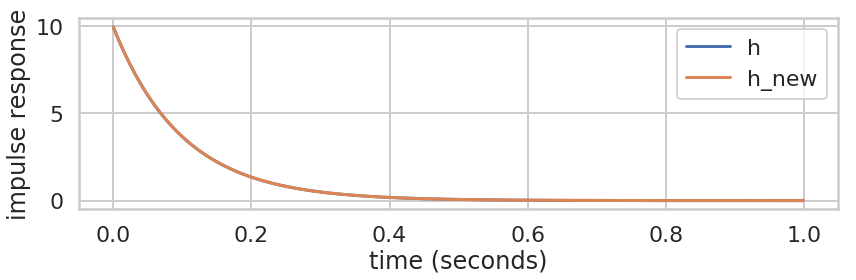

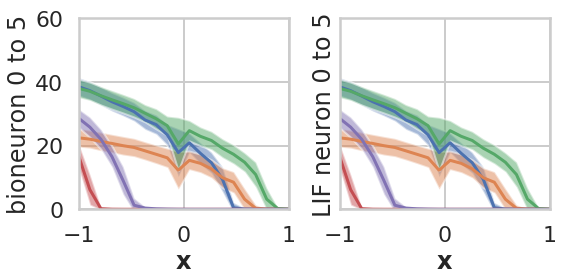

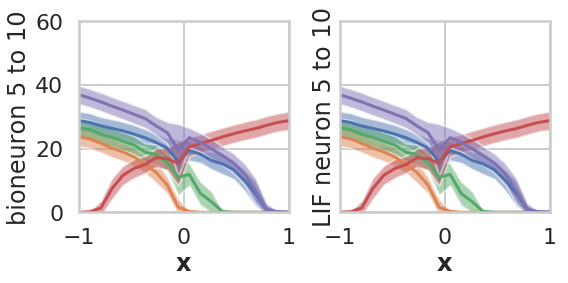

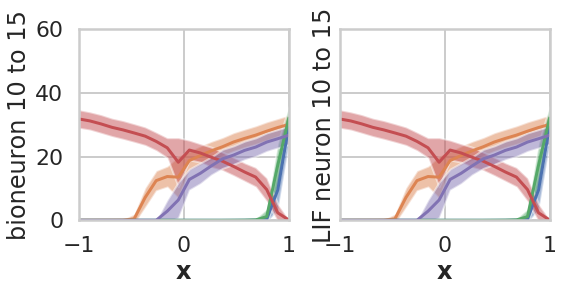

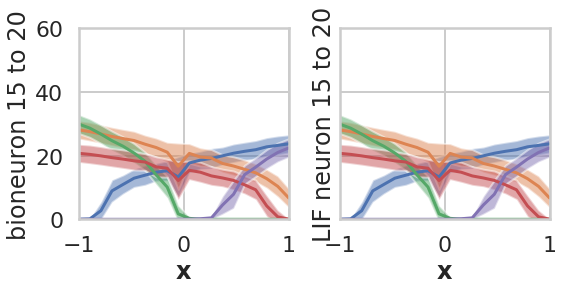

...

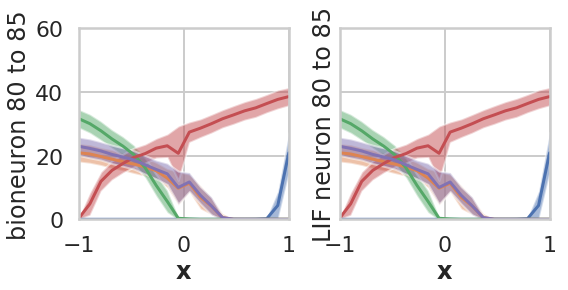

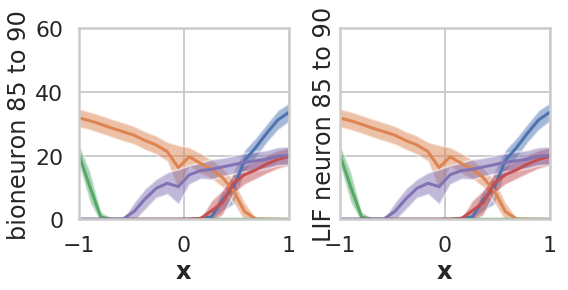

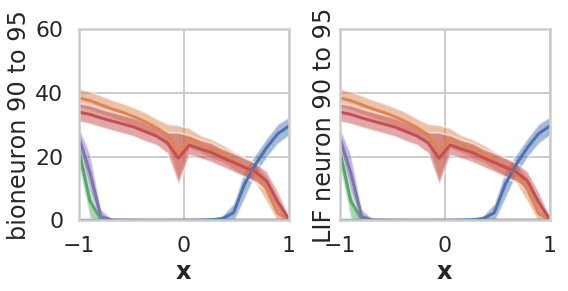

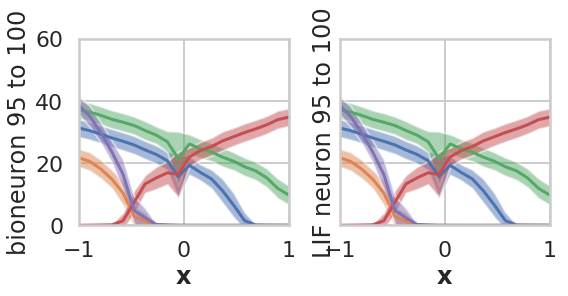

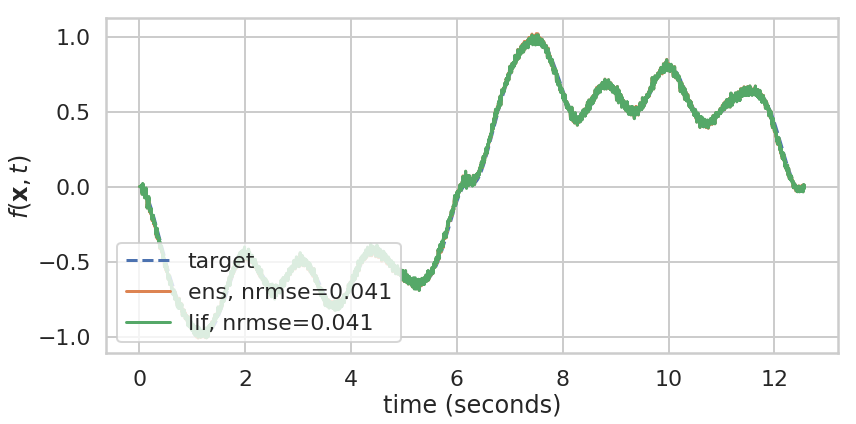

unsupervised simulation


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)
/home/pduggins/nengo/nengo/utils/numpy.py:79: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  v = a[inds]


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

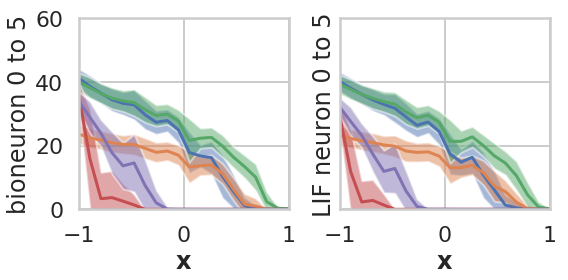

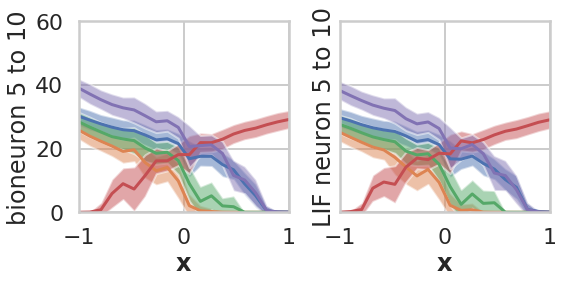

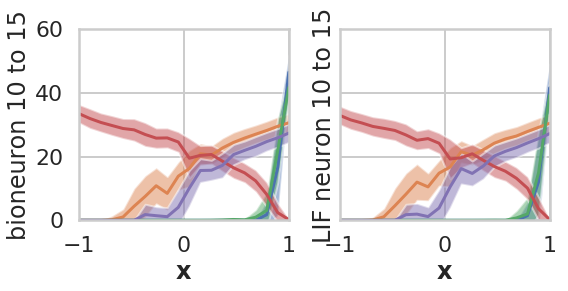

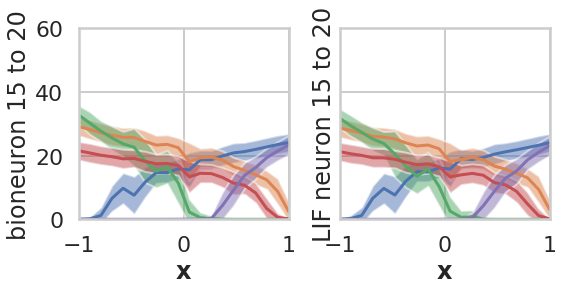

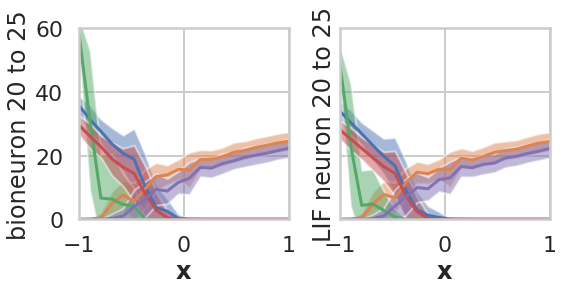

...

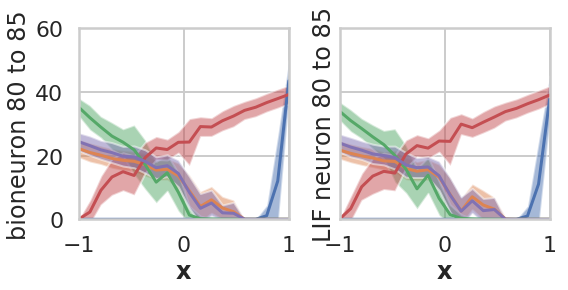

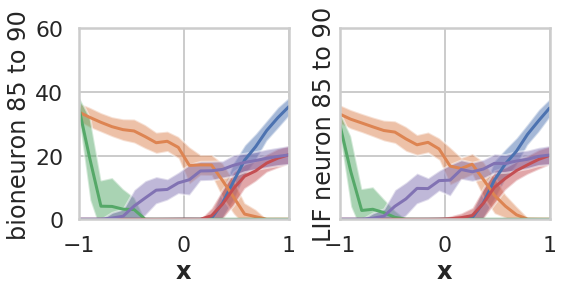

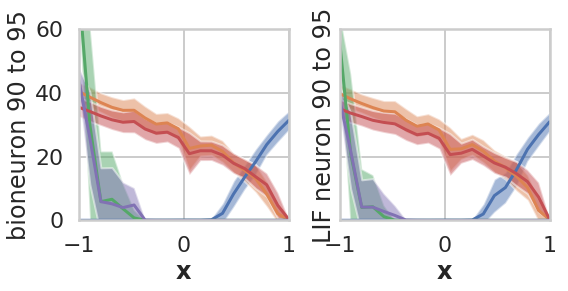

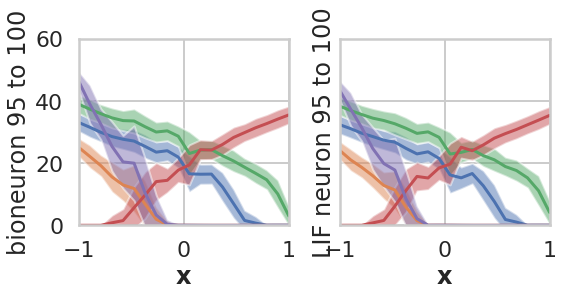

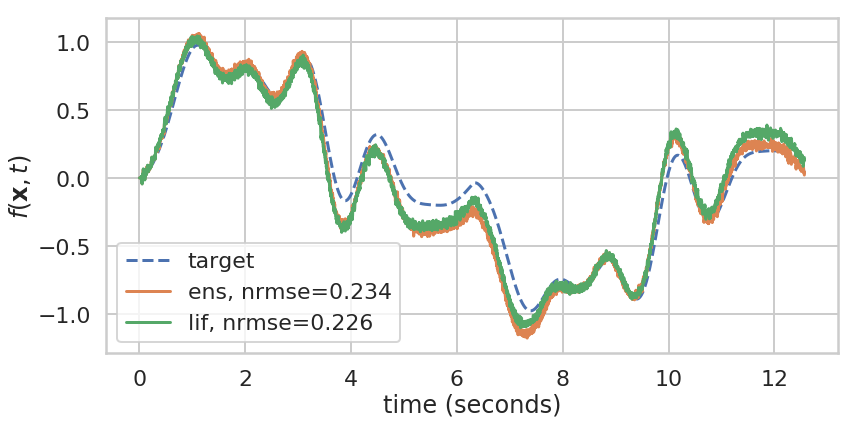

supervised simulation


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

least-squares optimization of recurrent filter and/or decoders


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:213: UserWarning: Synapse ((num=[ 1000. -1000.], den=[1. 0.], analog=False)) has extra delay due to passthrough (https://github.com/nengo/nengo/issues/938).
  "(https://github.com/nengo/nengo/issues/938)." % sys)


taus attempt 0, nonzero d 100, tau=[0.12837]: 


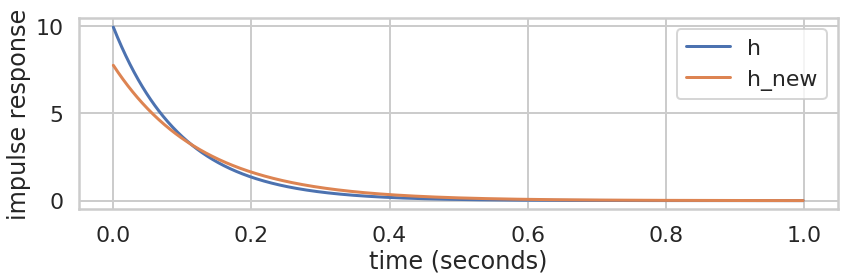

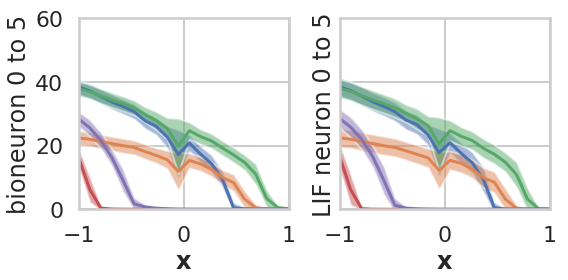

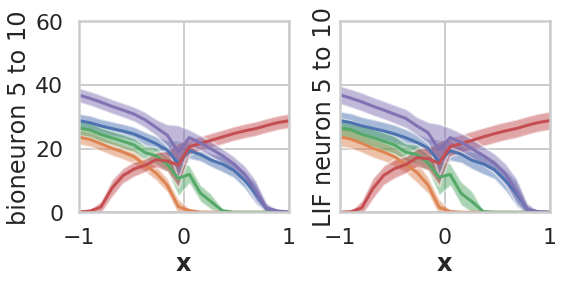

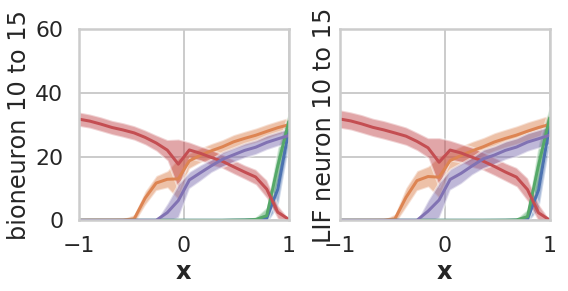

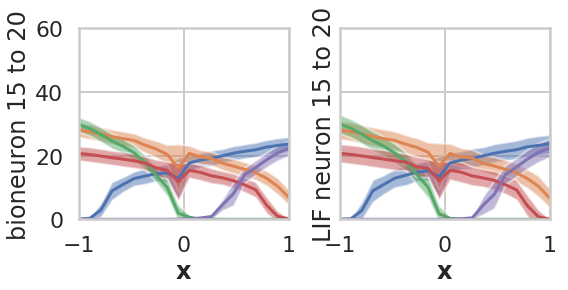

...

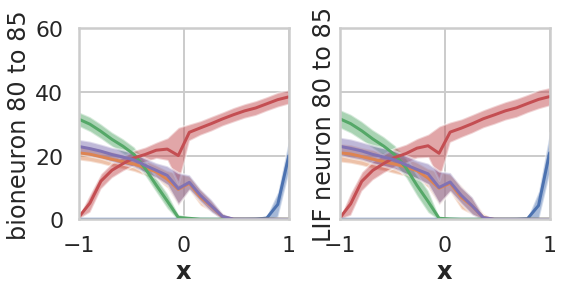

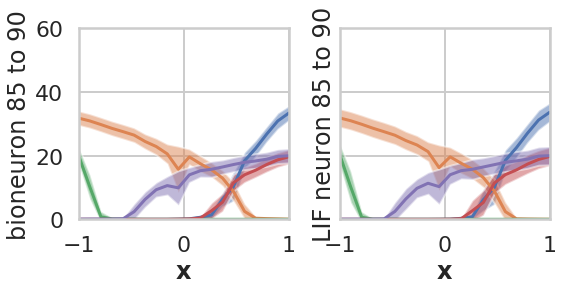

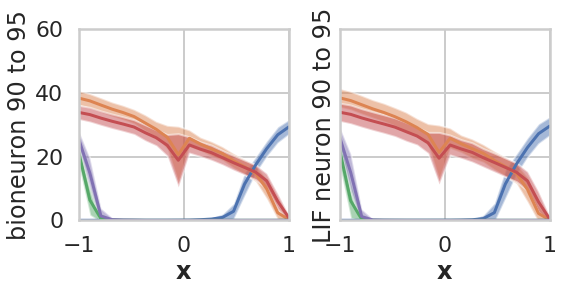

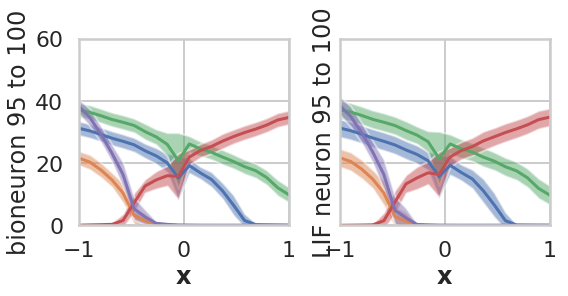

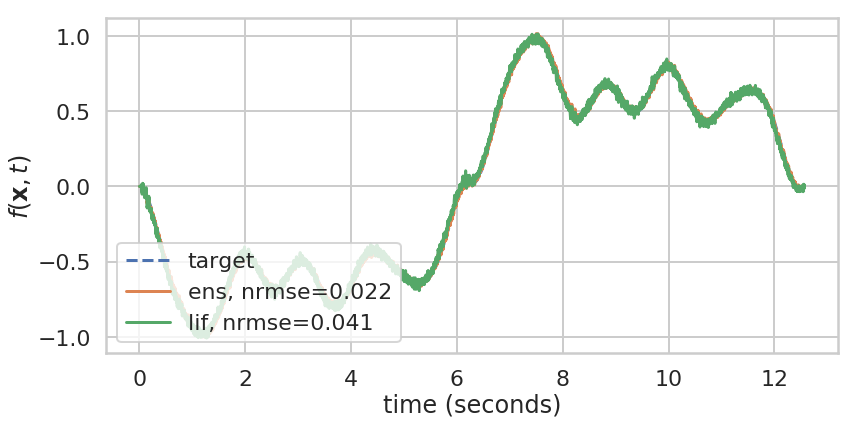

unsupervised simulation


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)
/home/pduggins/nengo/nengo/utils/numpy.py:79: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  v = a[inds]


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

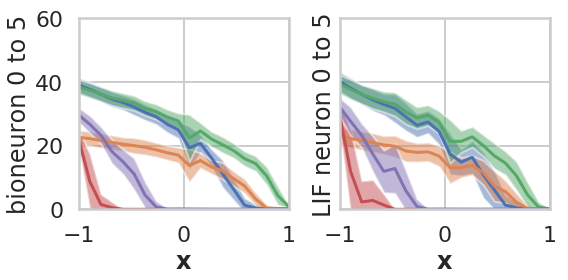

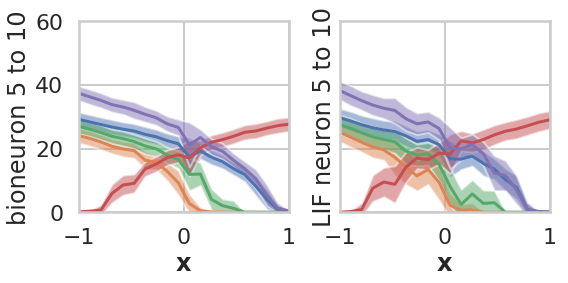

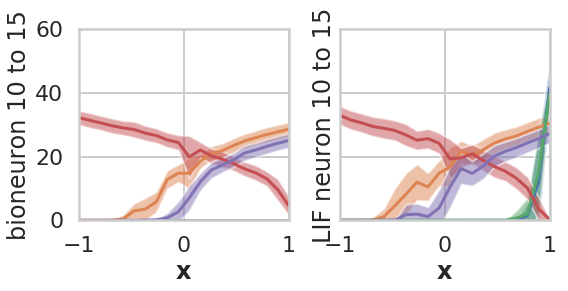

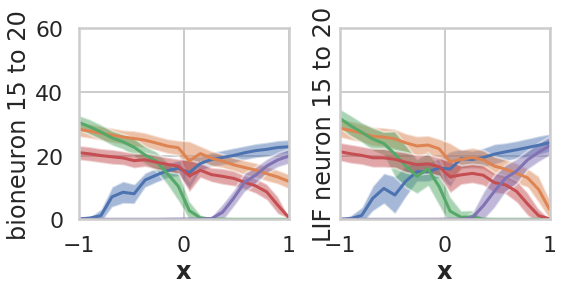

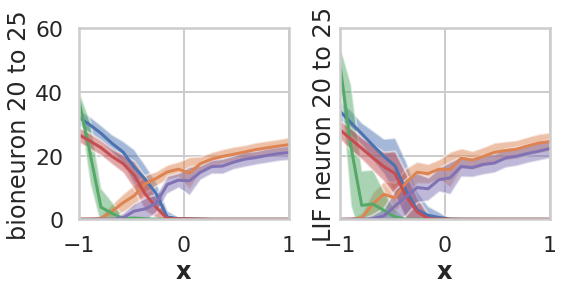

...

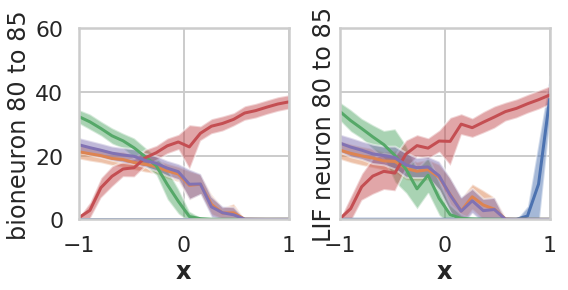

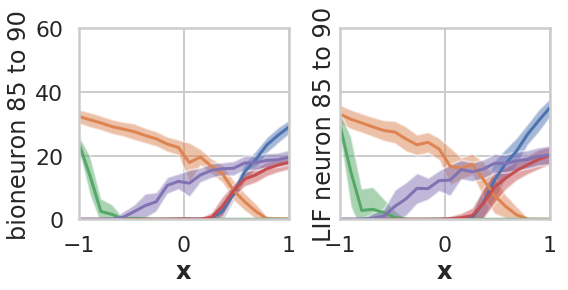

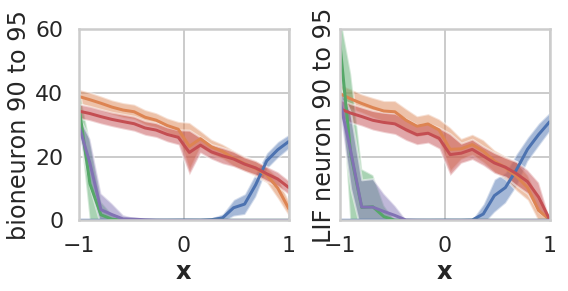

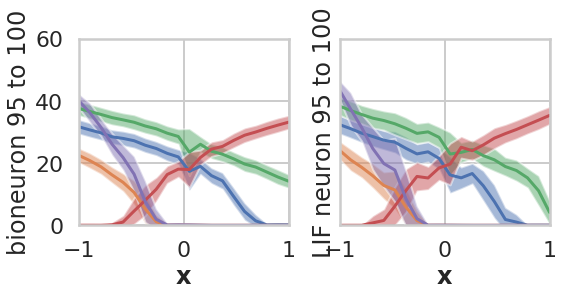

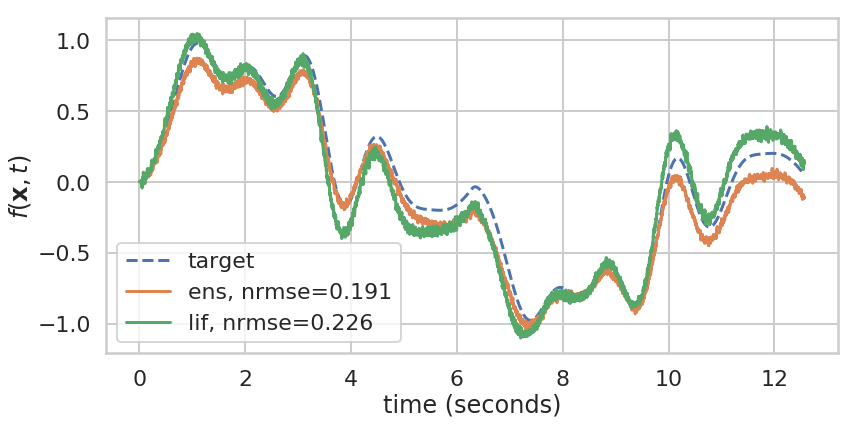

supervised simulation


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

least-squares optimization of recurrent filter and/or decoders


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:213: UserWarning: Synapse ((num=[ 1000. -1000.], den=[1. 0.], analog=False)) has extra delay due to passthrough (https://github.com/nengo/nengo/issues/938).
  "(https://github.com/nengo/nengo/issues/938)." % sys)
/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:213: UserWarning: Synapse ((A=[[-0.]], B=[[1.]], C=[[-1000.]], D=[[1000.]], analog=False)) has extra delay due to passthrough (https://github.com/nengo/nengo/issues/938).
  "(https://github.com/nengo/nengo/issues/938)." % sys)


taus attempt 0, nonzero d 100, tau=[0.13015 0.00185]: 


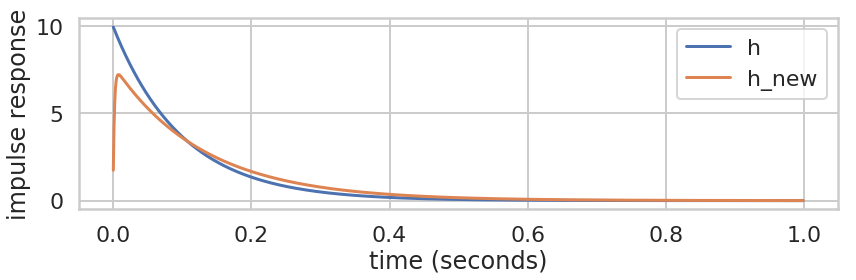

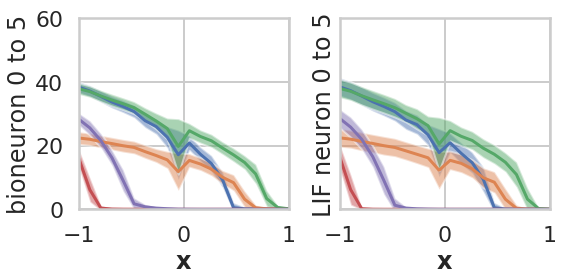

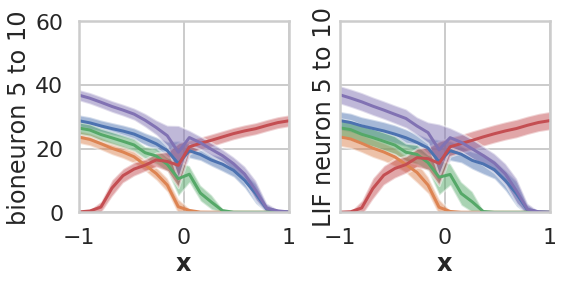

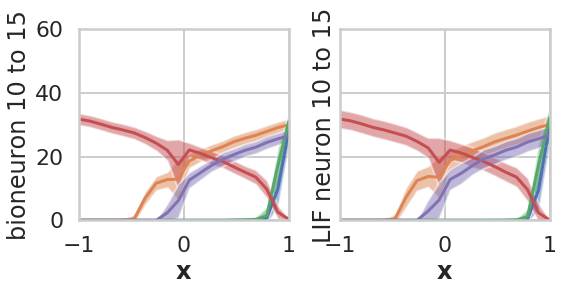

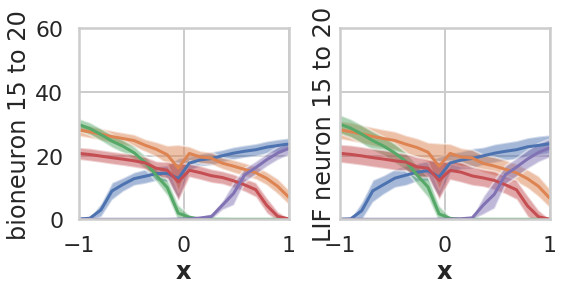

...

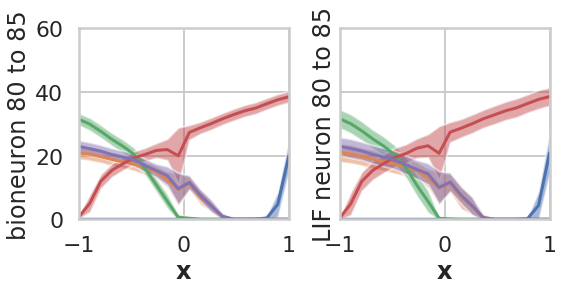

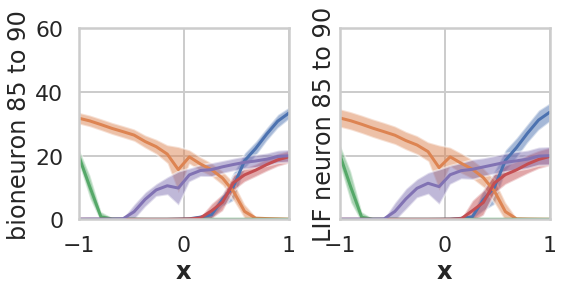

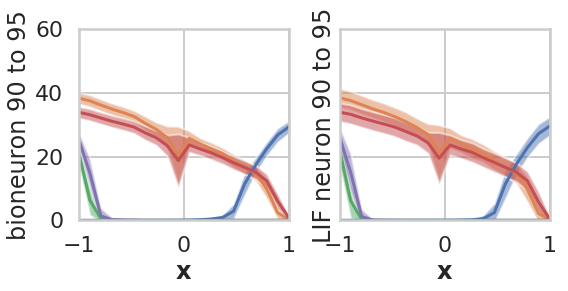

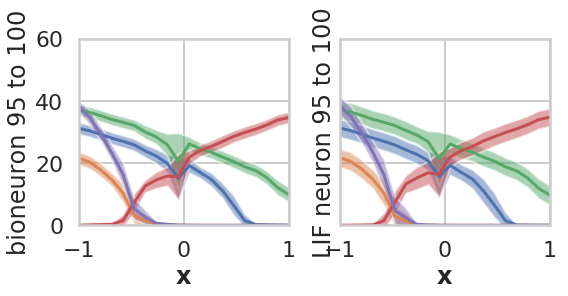

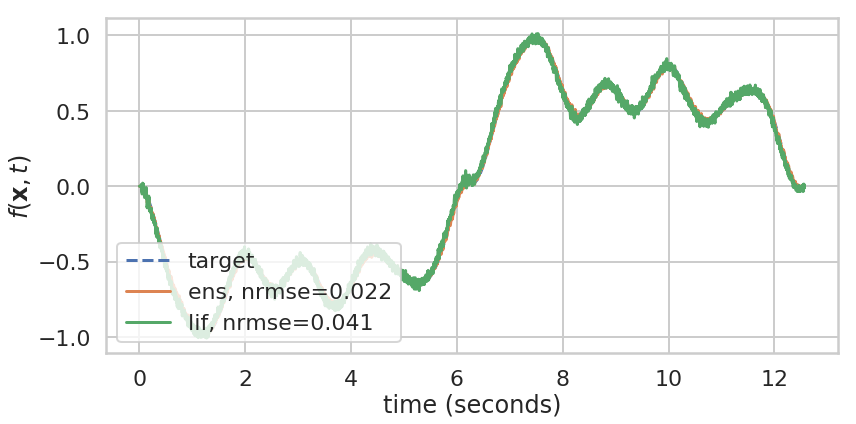

unsupervised simulation


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)
/home/pduggins/nengo/nengo/utils/numpy.py:79: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  v = a[inds]


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

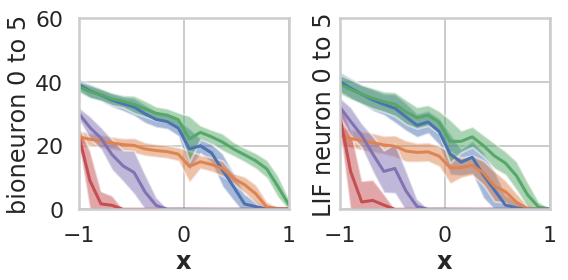

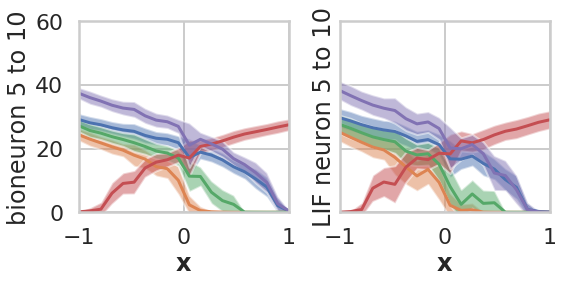

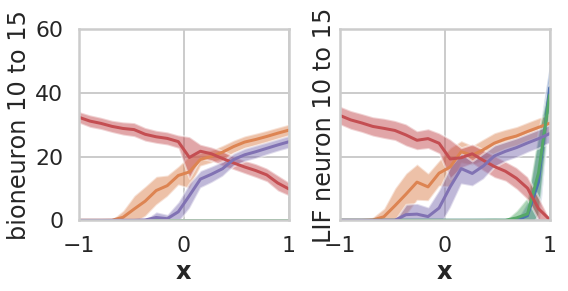

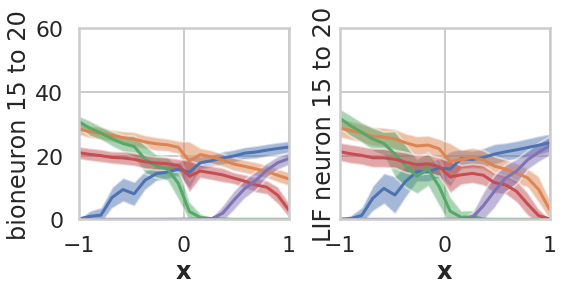

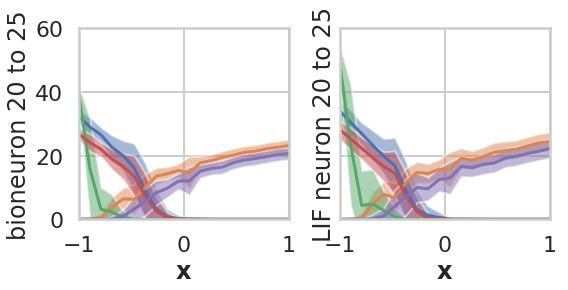

...

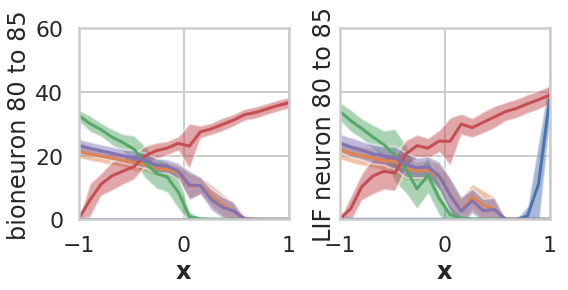

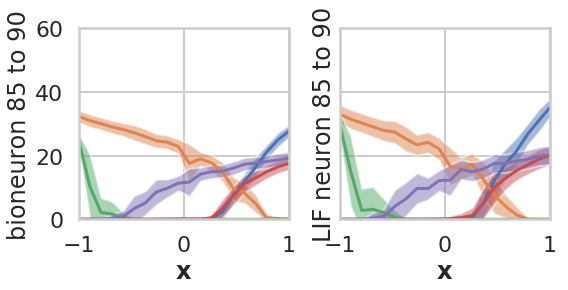

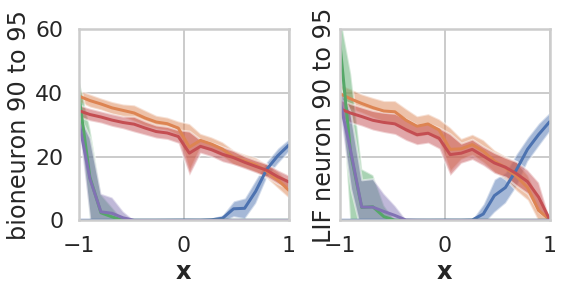

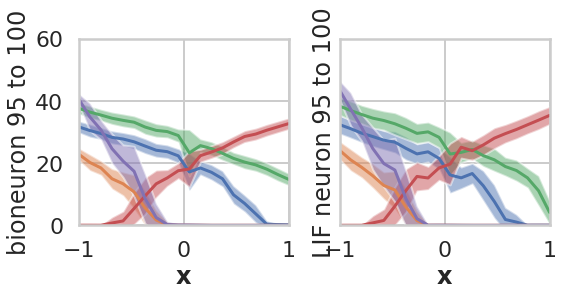

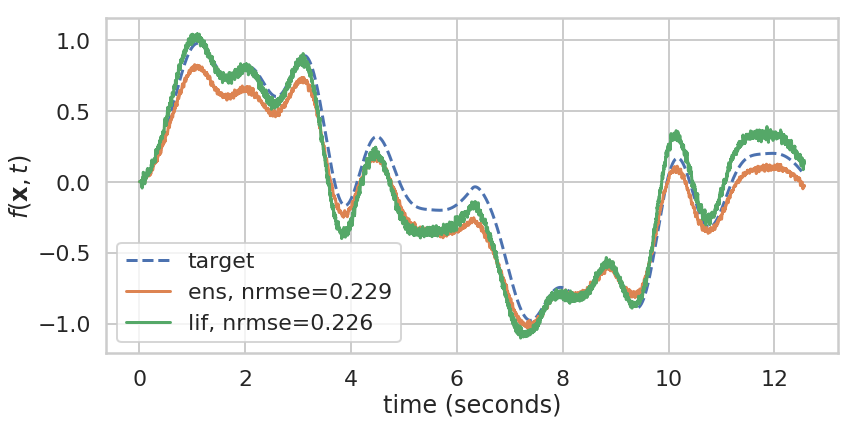

In [10]:
n_neurons = 100
max_rates = Uniform(20, 40)
intercepts = Uniform(-1, 1)
neuron_type = nengo.LIF()
t = 4*np.pi
dt = 0.001

d_new, h_new, data_train, data_test, gbdict = run_once(t, n_neurons, neuron_type, max_rates, intercepts,
    dt=dt, pt=True, pe=True, pf=True, optimize_h=False)

d_new, h_new, data_train, data_test, gbdict = run_once(t, n_neurons, neuron_type, max_rates, intercepts,
    dt=dt, pt=True, pe=True, pf=True, optimize_h=True)

d_new, h_new, data_train, data_test, gbdict = run_once(t, n_neurons, neuron_type, max_rates, intercepts,
    dt=dt, pt=True, pe=True, pf=True, optimize_h=True, order=2)

supervised simulation


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

least-squares optimization of recurrent filter and/or decoders


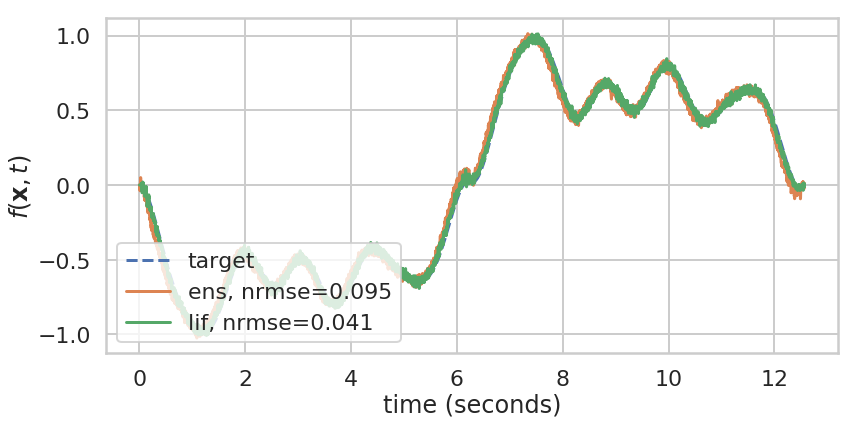

unsupervised simulation


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)
/home/pduggins/nengo/nengo/utils/numpy.py:79: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  v = a[inds]


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

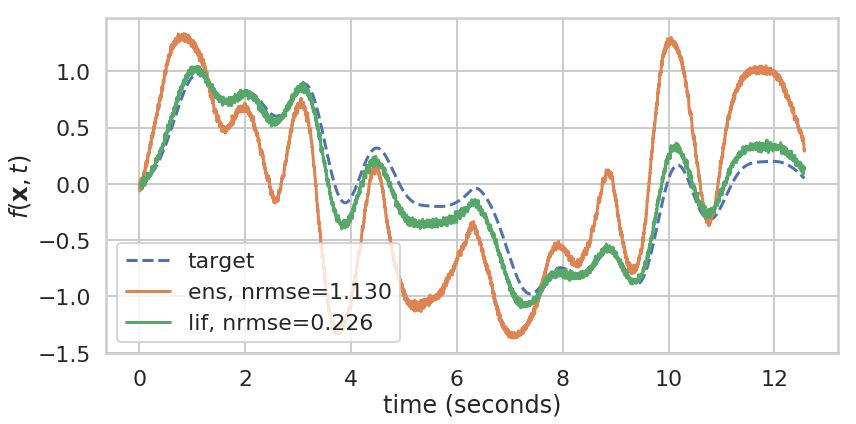

supervised simulation


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

least-squares optimization of recurrent filter and/or decoders


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:213: UserWarning: Synapse ((num=[ 1000. -1000.], den=[1. 0.], analog=False)) has extra delay due to passthrough (https://github.com/nengo/nengo/issues/938).
  "(https://github.com/nengo/nengo/issues/938)." % sys)


taus attempt 0, nonzero d 100, tau=[0.18708]: 


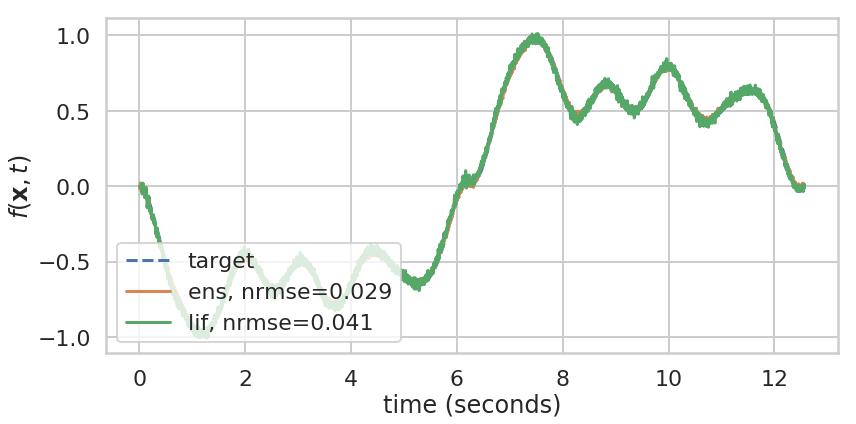

unsupervised simulation


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)
/home/pduggins/nengo/nengo/utils/numpy.py:79: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  v = a[inds]


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

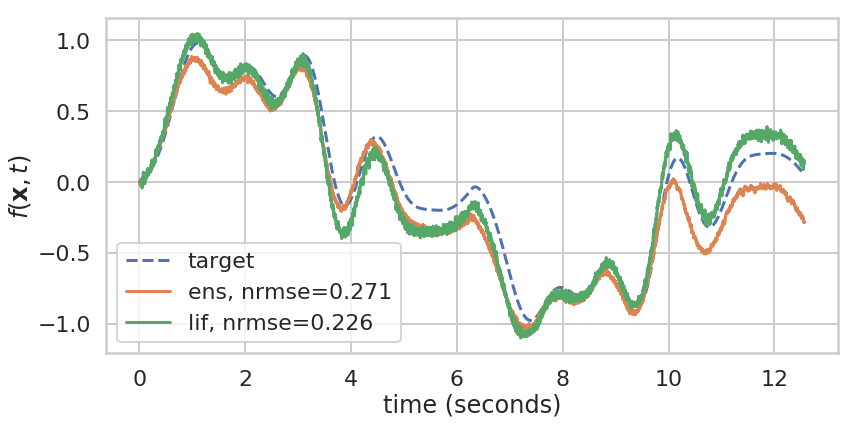

supervised simulation


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

least-squares optimization of recurrent filter and/or decoders


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:213: UserWarning: Synapse ((num=[ 1000. -1000.], den=[1. 0.], analog=False)) has extra delay due to passthrough (https://github.com/nengo/nengo/issues/938).
  "(https://github.com/nengo/nengo/issues/938)." % sys)
/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:213: UserWarning: Synapse ((A=[[-0.]], B=[[1.]], C=[[-1000.]], D=[[1000.]], analog=False)) has extra delay due to passthrough (https://github.com/nengo/nengo/issues/938).
  "(https://github.com/nengo/nengo/issues/938)." % sys)


taus attempt 0, nonzero d 100, tau=[0.18911 0.00049]: 


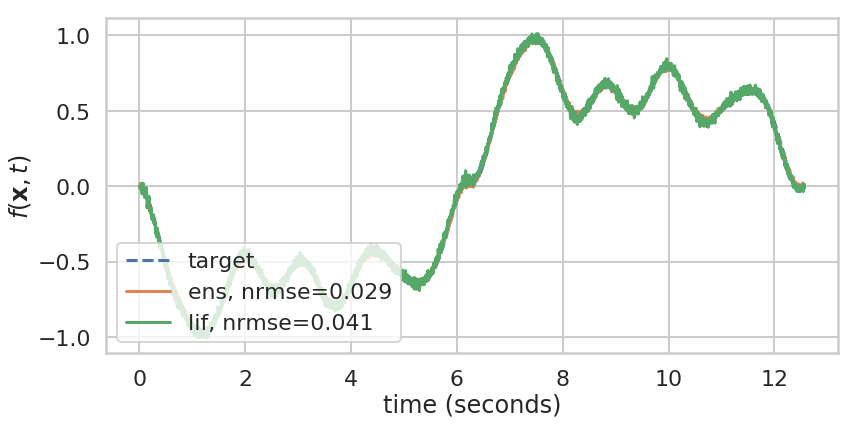

unsupervised simulation


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)
/home/pduggins/nengo/nengo/utils/numpy.py:79: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  v = a[inds]


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

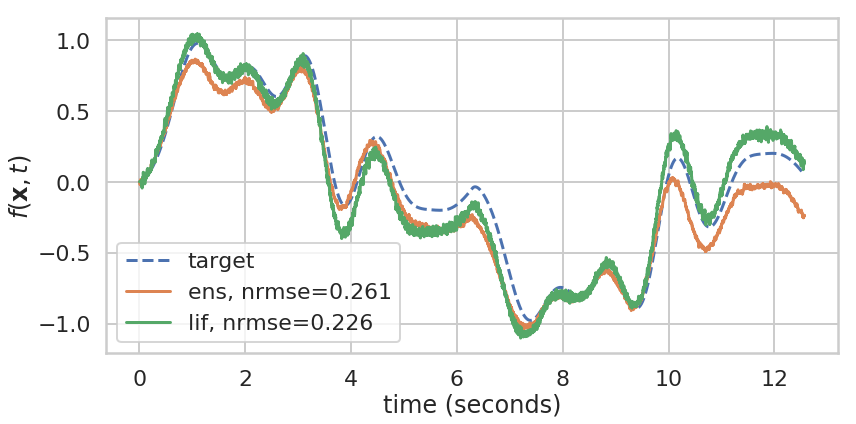

In [11]:
n_neurons = 100
max_rates = Uniform(20, 40)
intercepts = Uniform(-1, 1)
neuron_type = AdaptiveLIFT(tau_adapt=0.1, inc_adapt=0.1)
t = 4*np.pi

d_new, h_new, data_train, data_test, gbdict = run_once(t, n_neurons, neuron_type, max_rates, intercepts,
    optimize_h=False)

d_new, h_new, data_train, data_test, gbdict = run_once(t, n_neurons, neuron_type, max_rates, intercepts,
    optimize_h=True)

d_new, h_new, data_train, data_test, gbdict = run_once(t, n_neurons, neuron_type, max_rates, intercepts,
    optimize_h=True, order=2)

In [ ]:
n_neurons = 100
max_rates = Uniform(20, 40)
intercepts = Uniform(-1, 1)
neuron_type = WilsonEuler()
t = 4*np.pi

d_new, h_new, data_train, data_test, gbdict = run_once(t, n_neurons, neuron_type, max_rates, intercepts,
    dt=0.00005, optimize_h=False)

d_new, h_new, data_train, data_test, gbdict = run_once(t, n_neurons, neuron_type, max_rates, intercepts,
    dt=0.00005, optimize_h=True)

d_new, h_new, data_train, data_test, gbdict = run_once(t, n_neurons, neuron_type, max_rates, intercepts,
    dt=0.00005, optimize_h=True, order=2)

optimizing gain and bias
<Connection pre_u_ens>


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


attempt 0


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

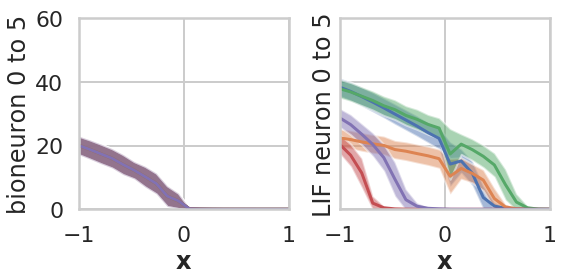

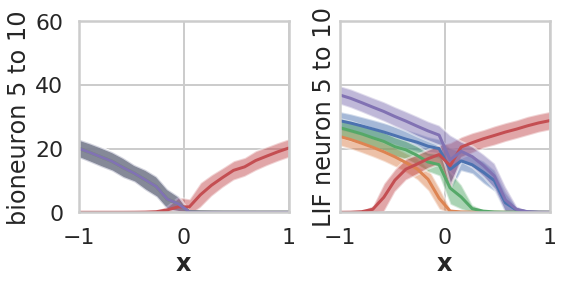

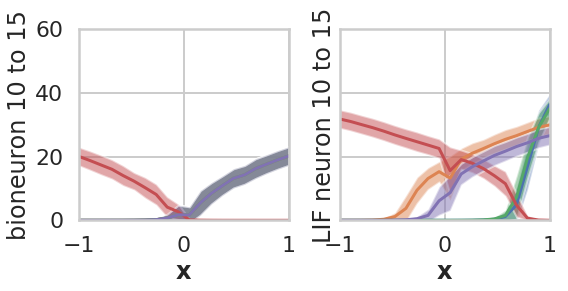

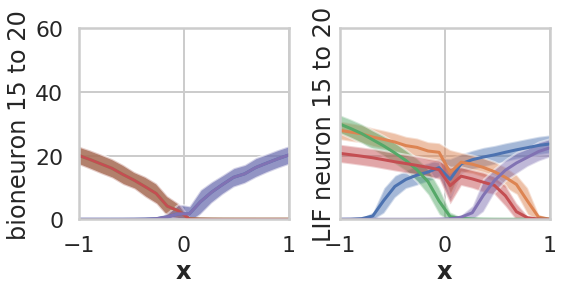

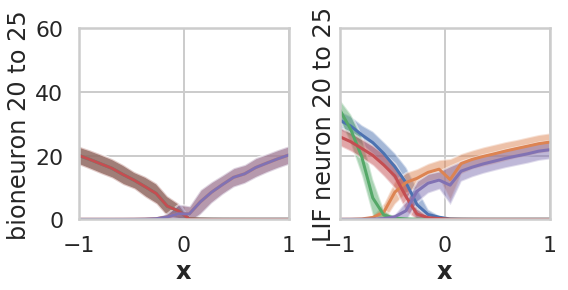

...

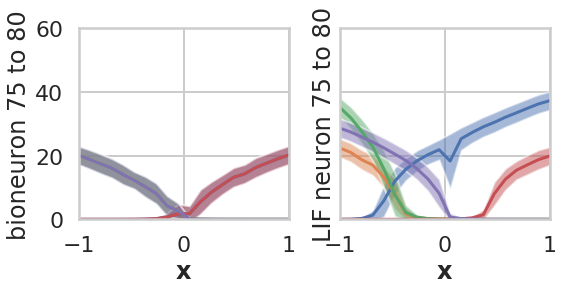

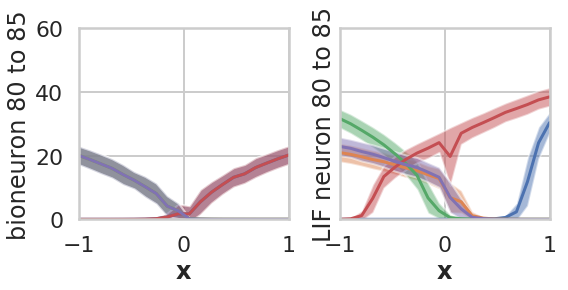

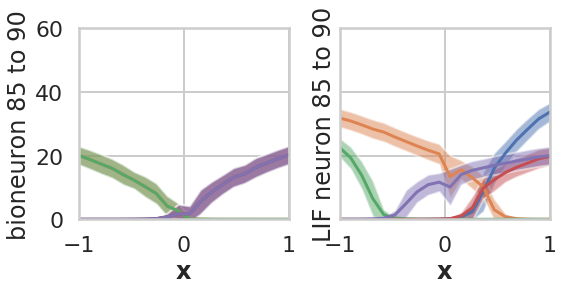

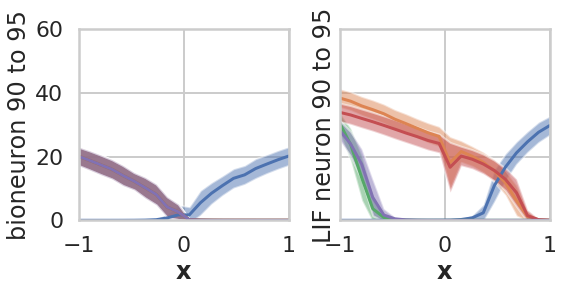

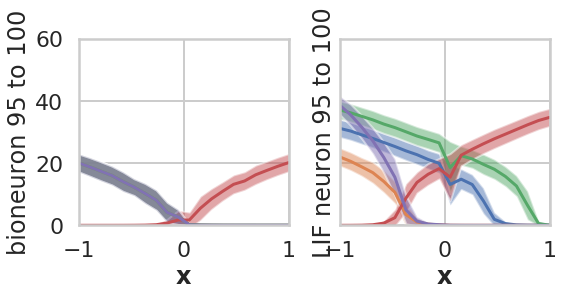

attempt 1


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

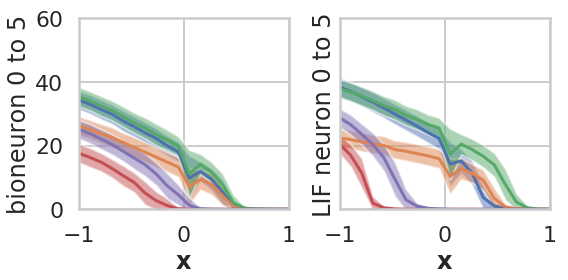

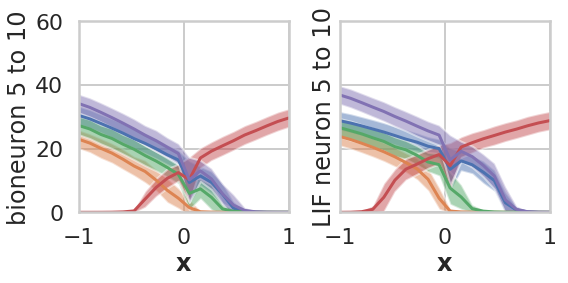

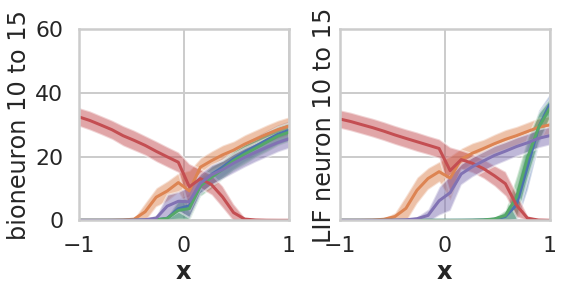

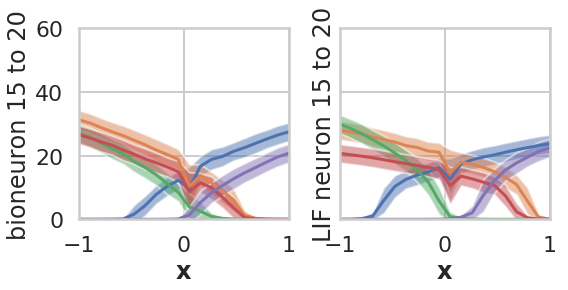

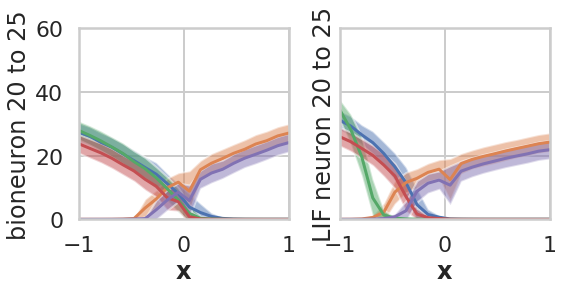

...

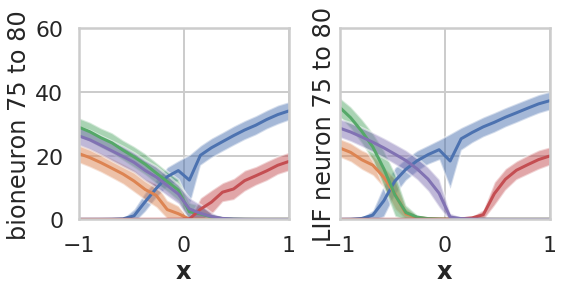

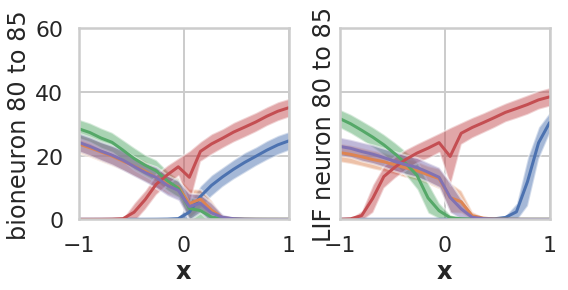

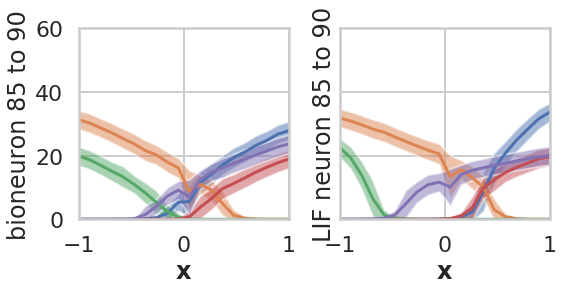

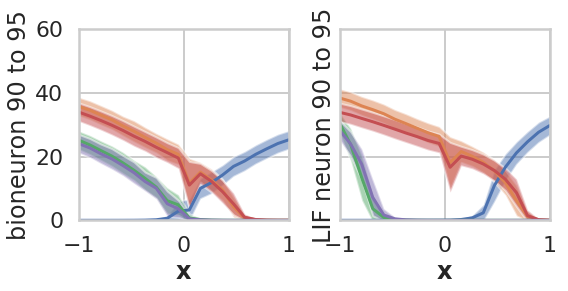

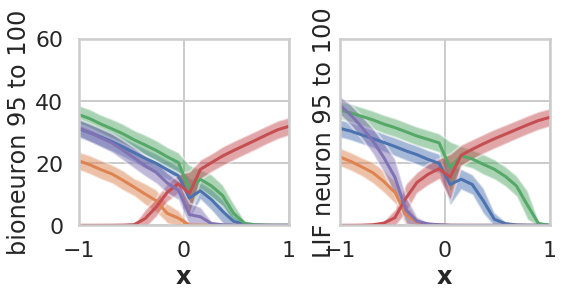

attempt 2


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

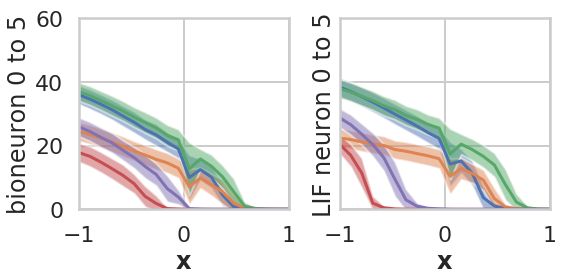

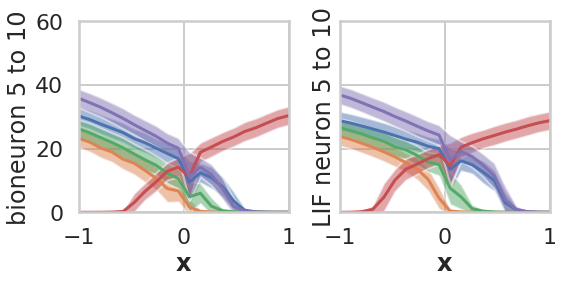

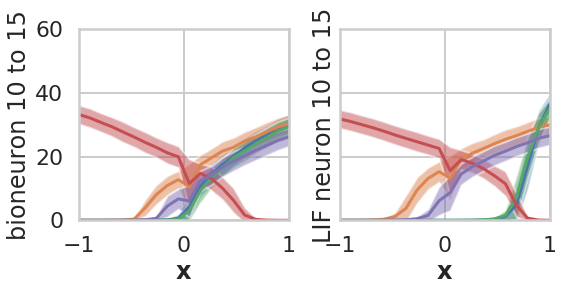

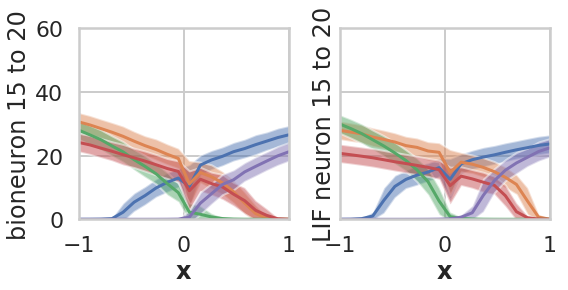

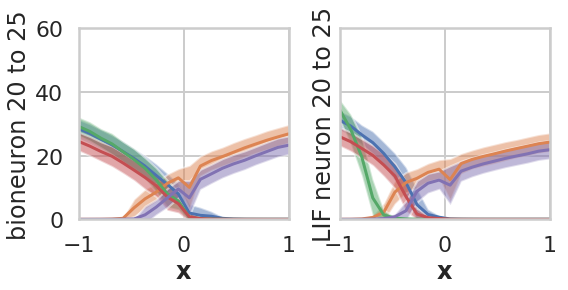

...

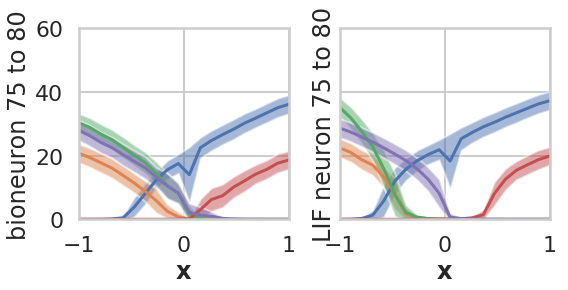

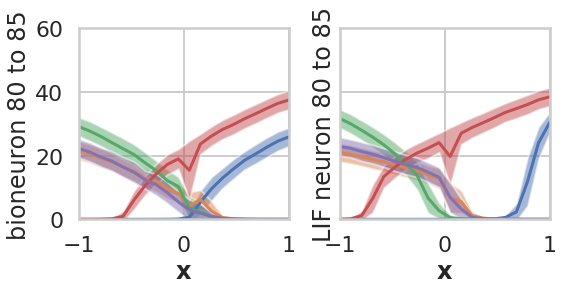

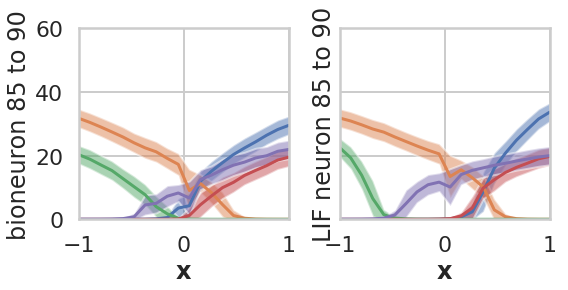

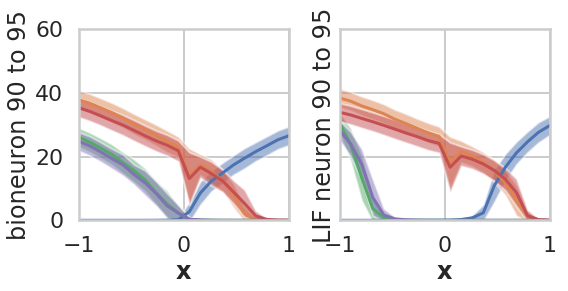

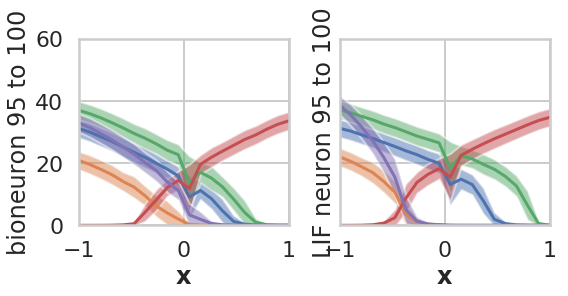

attempt 3


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

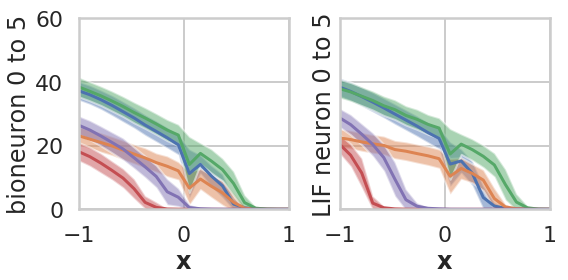

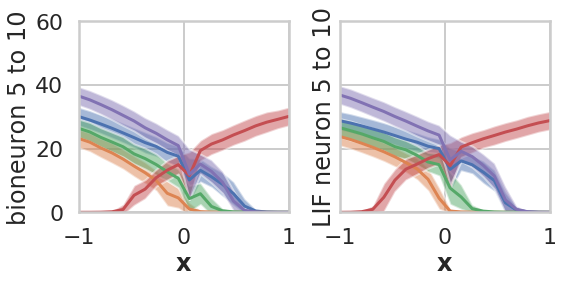

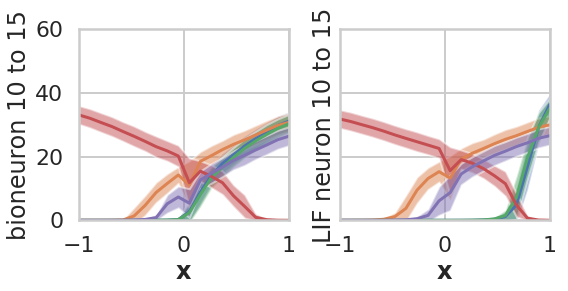

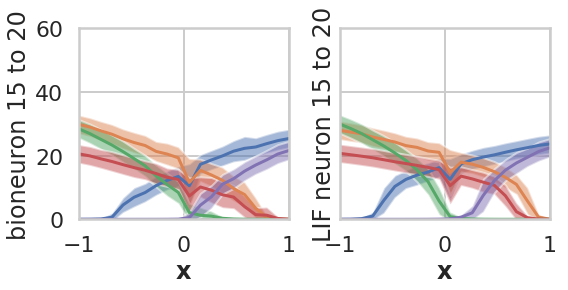

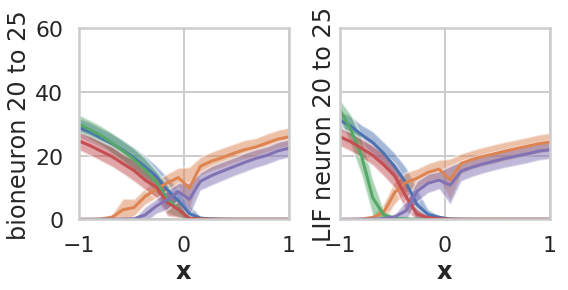

...

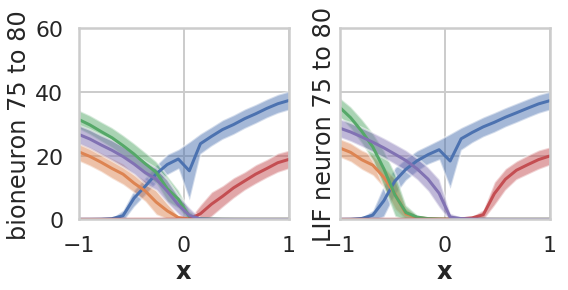

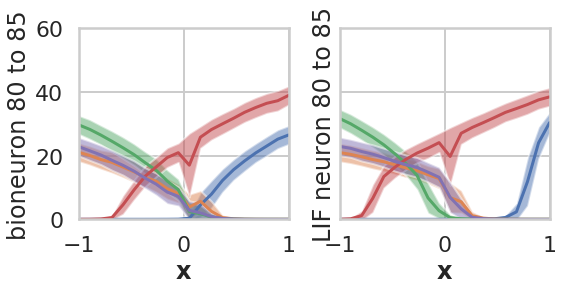

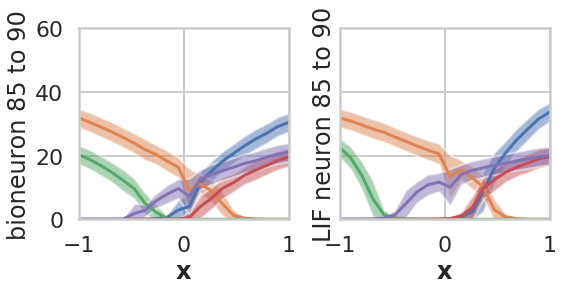

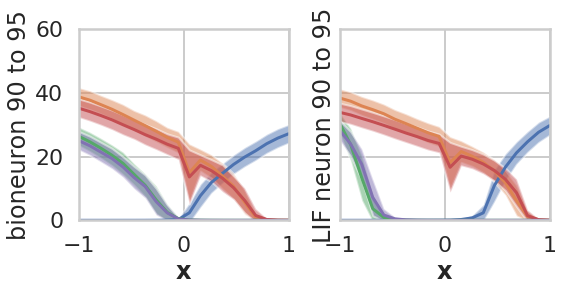

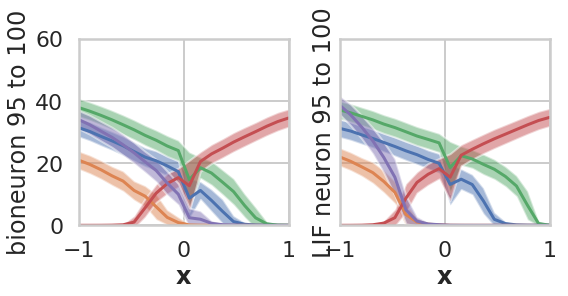

attempt 4


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

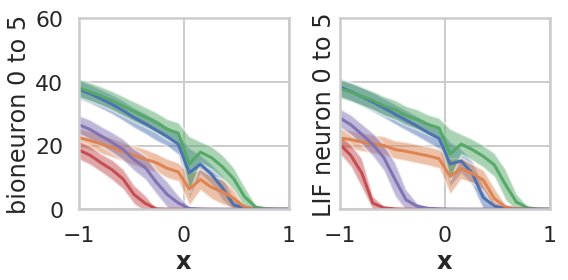

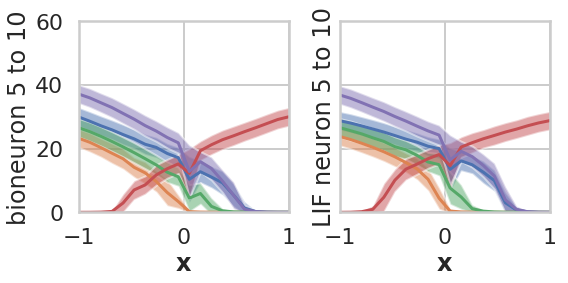

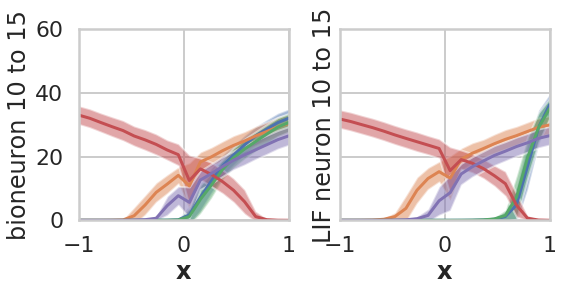

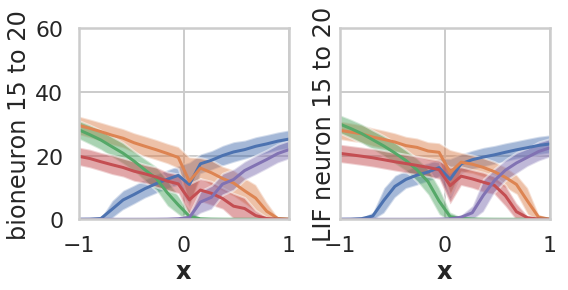

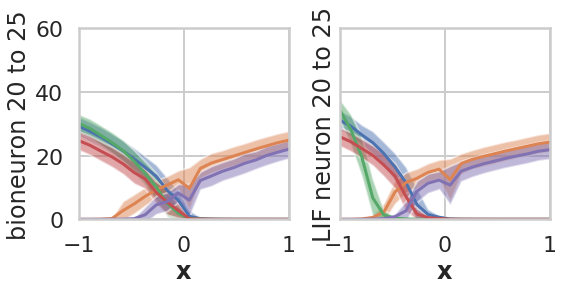

...

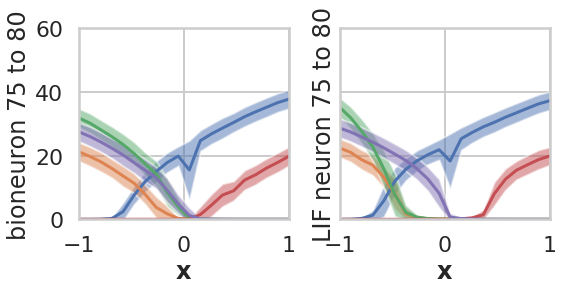

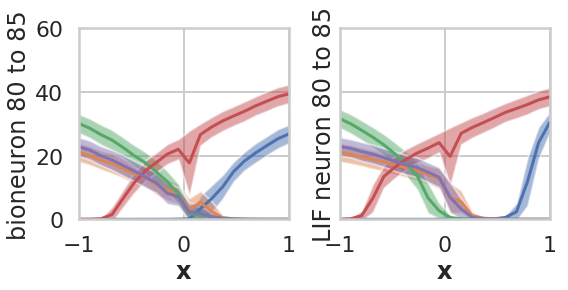

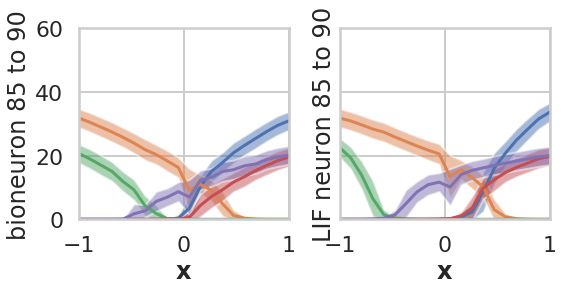

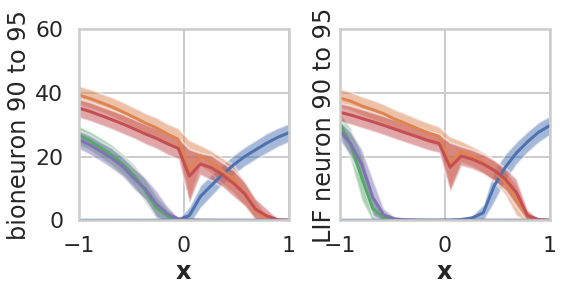

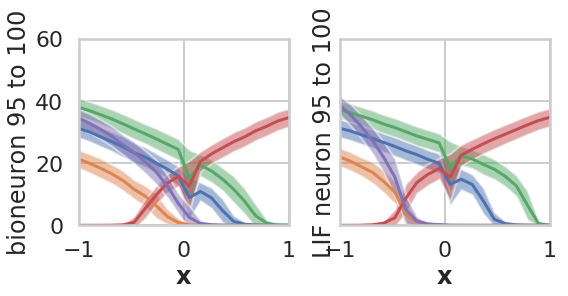

attempt 5


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

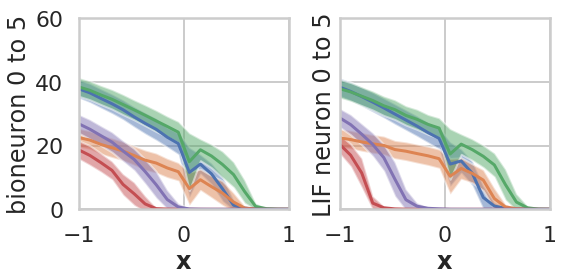

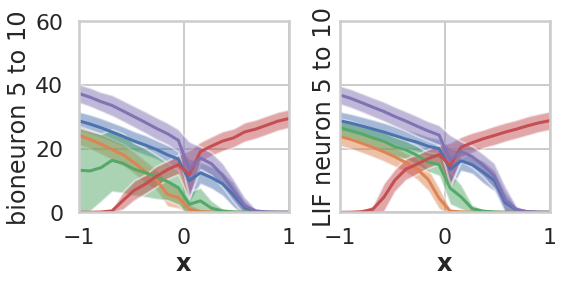

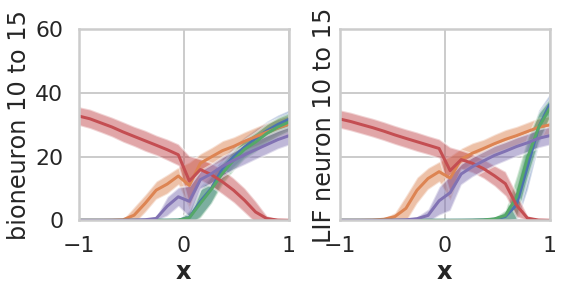

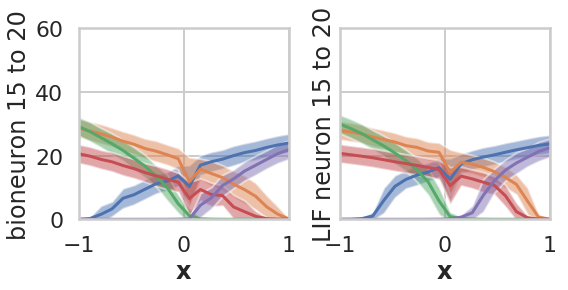

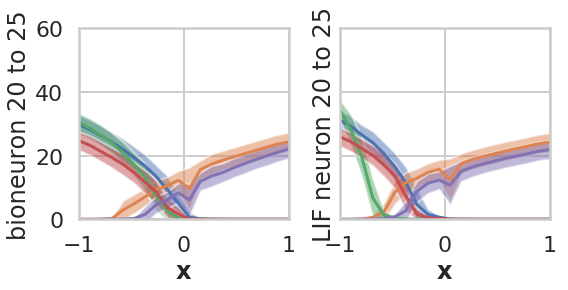

...

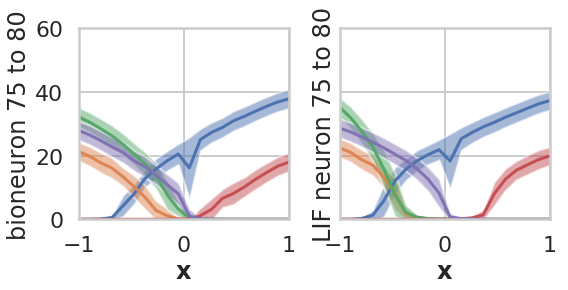

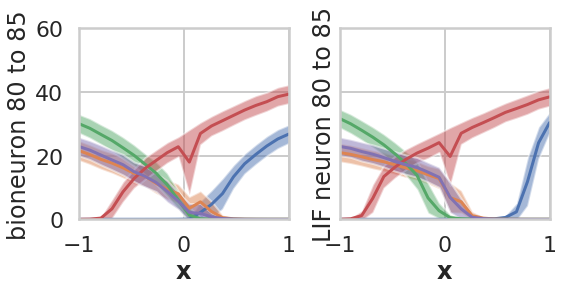

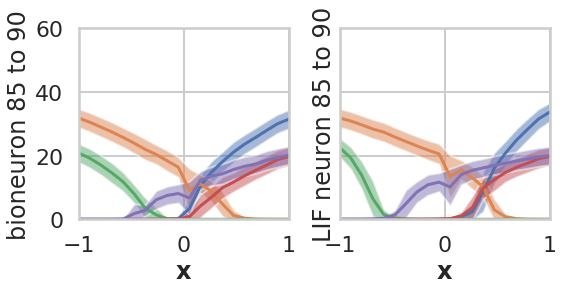

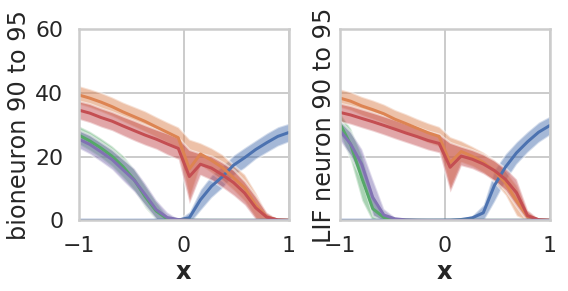

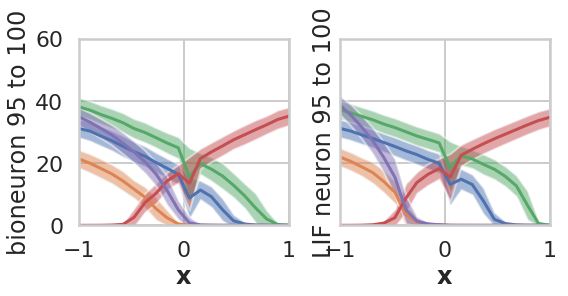

attempt 6


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

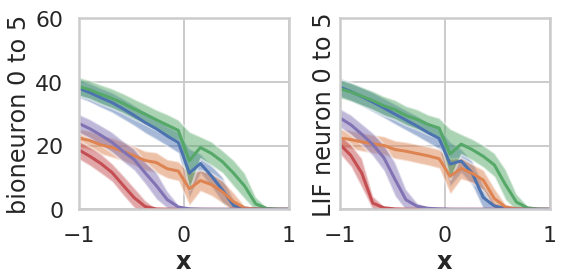

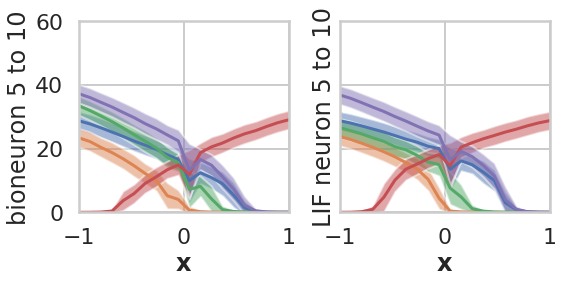

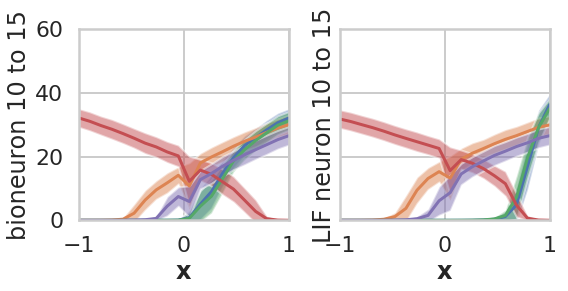

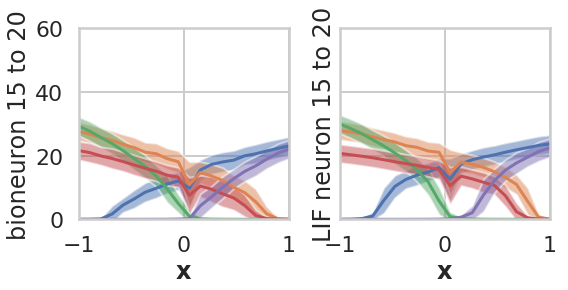

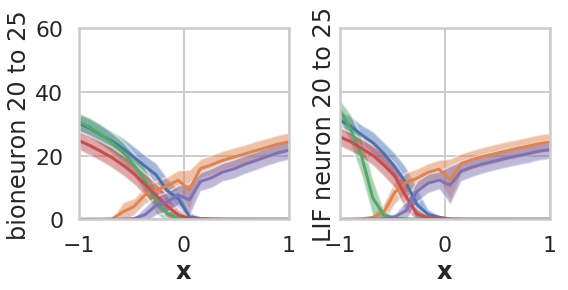

...

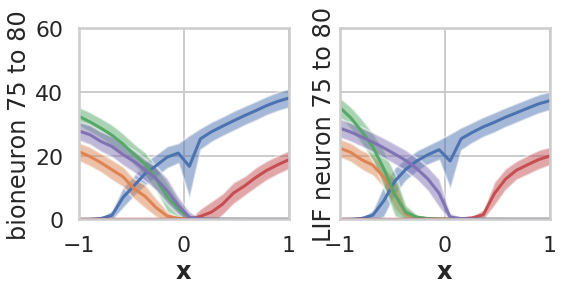

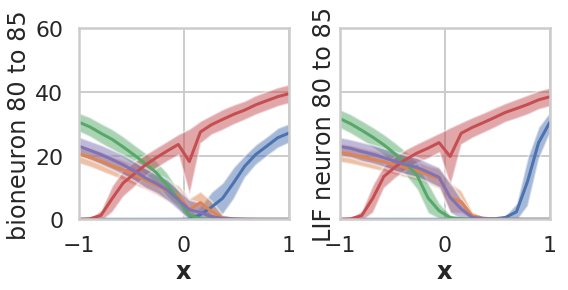

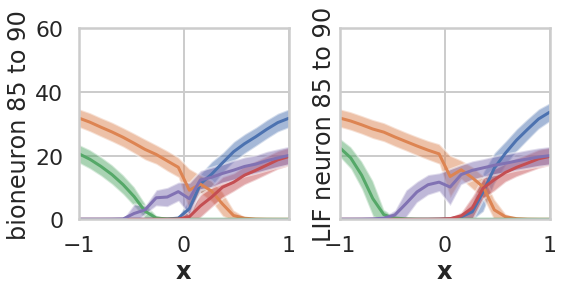

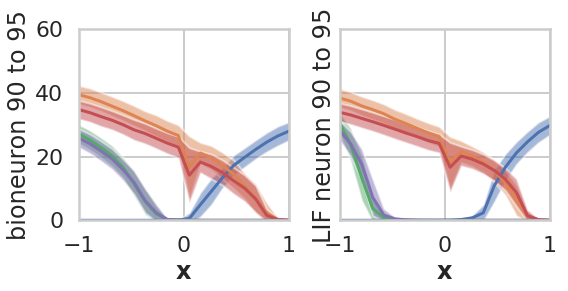

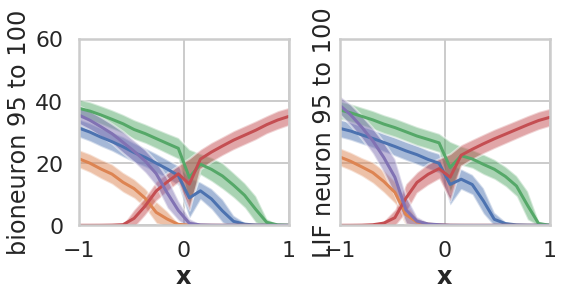

attempt 7


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

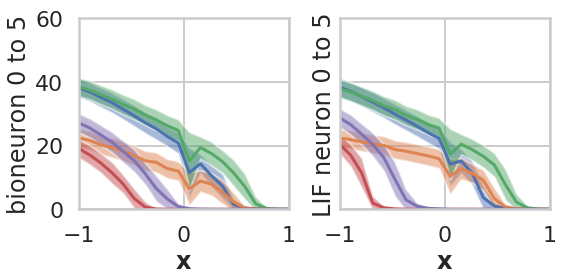

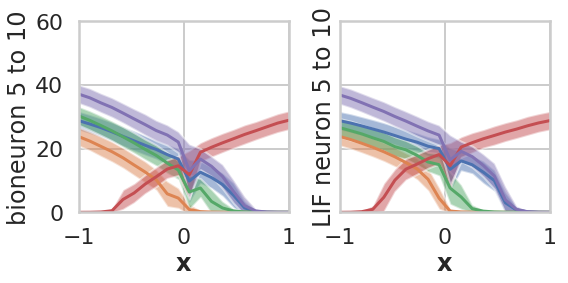

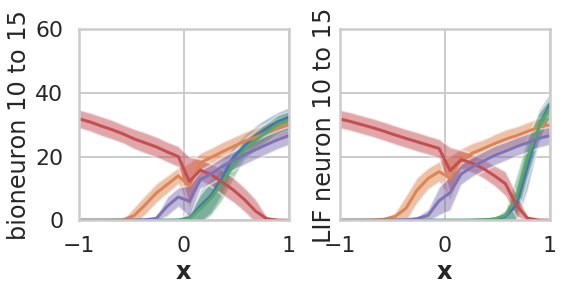

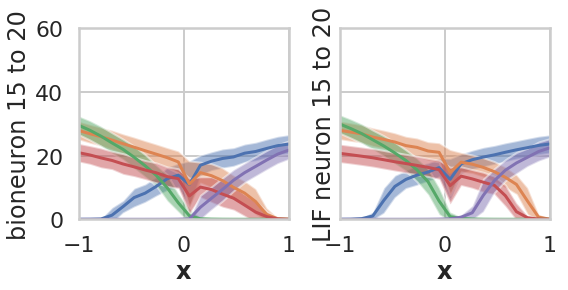

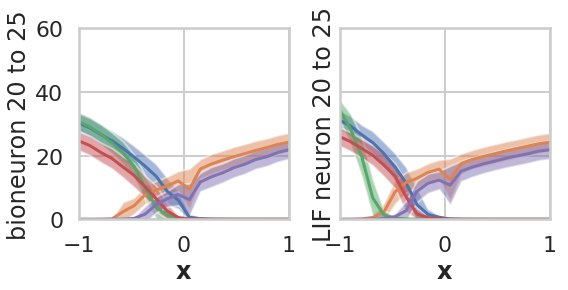

...

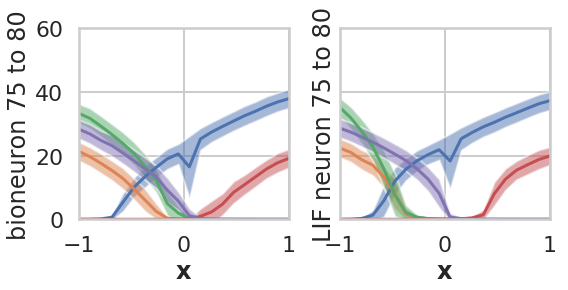

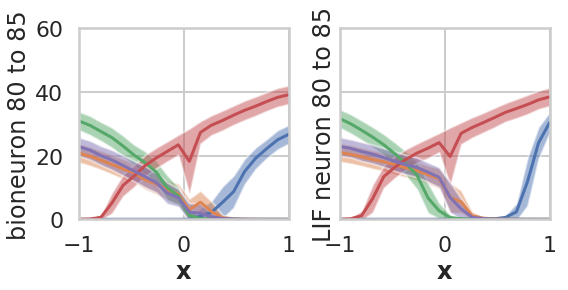

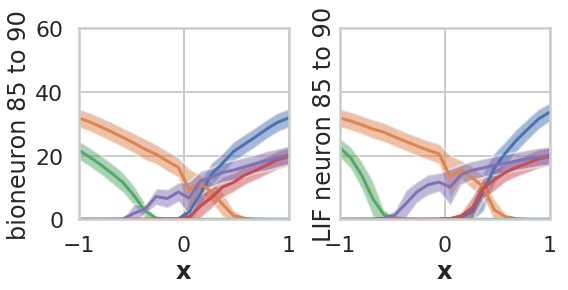

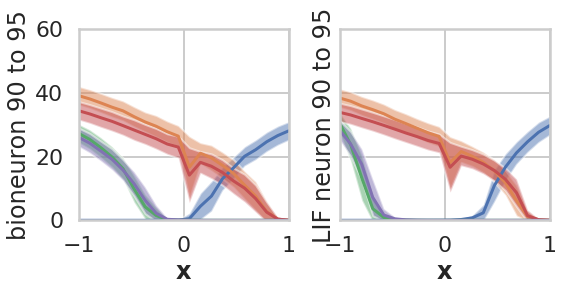

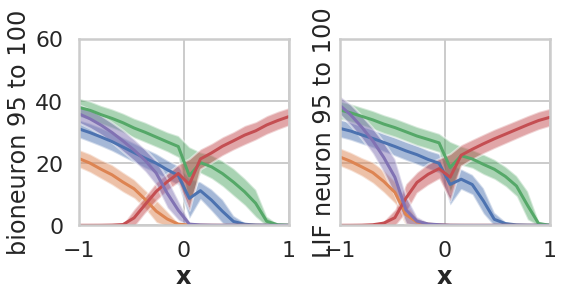

attempt 8


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

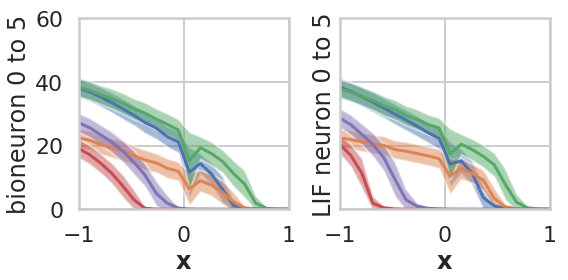

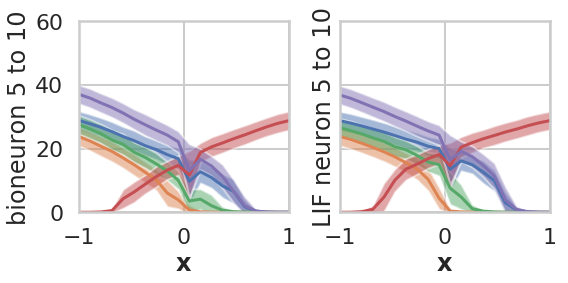

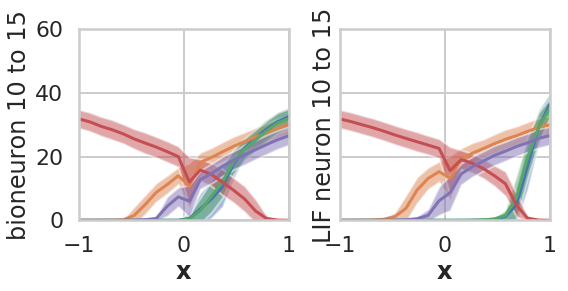

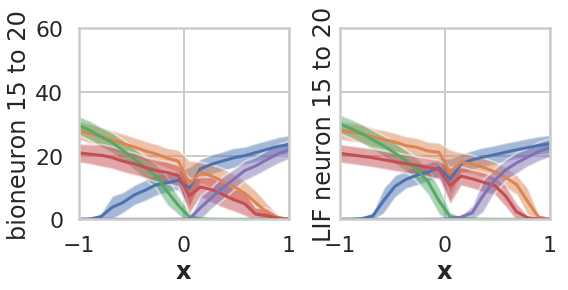

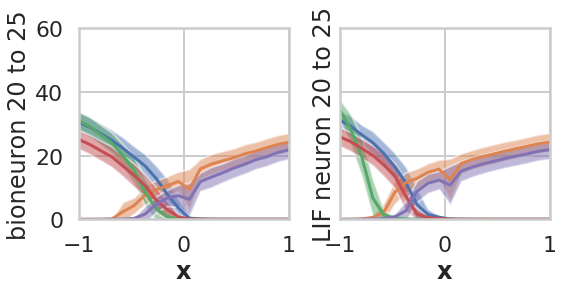

...

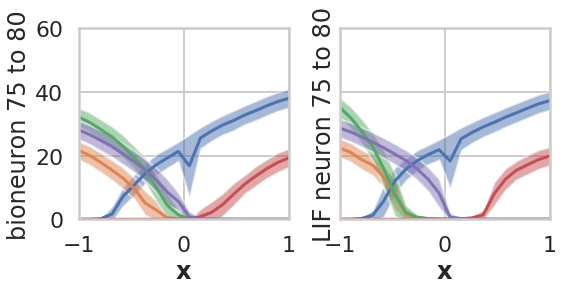

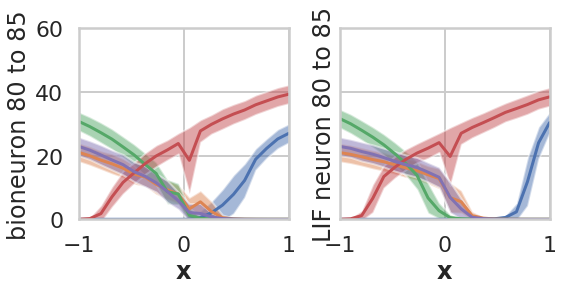

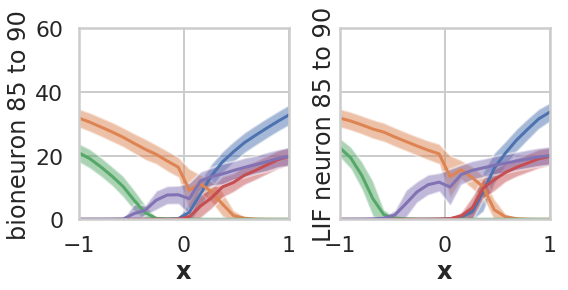

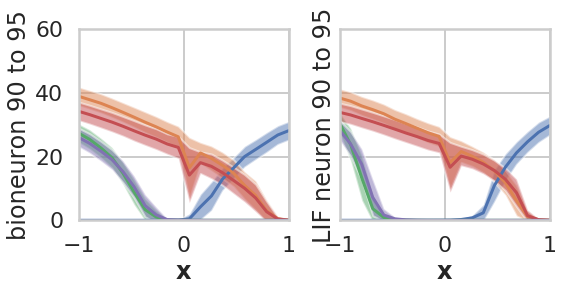

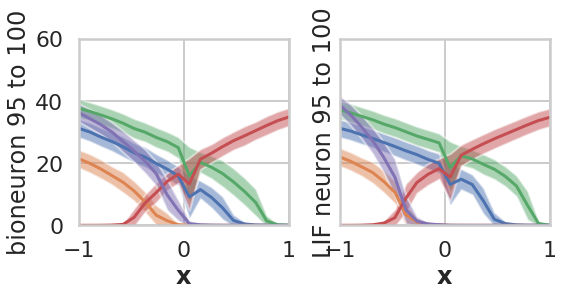

attempt 9


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

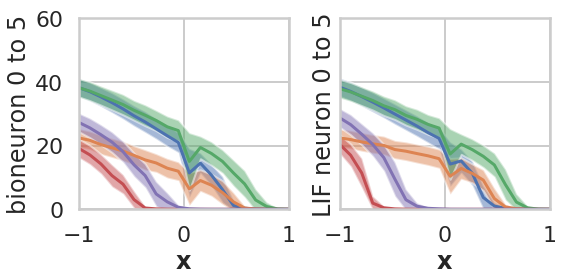

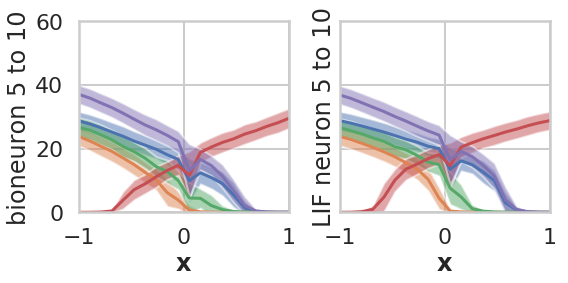

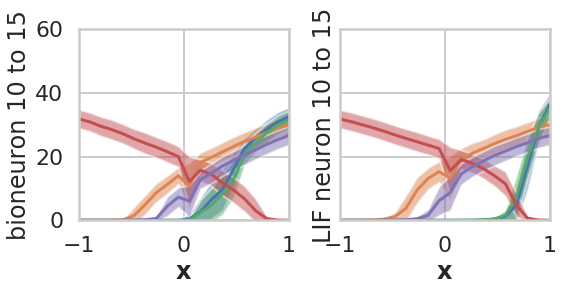

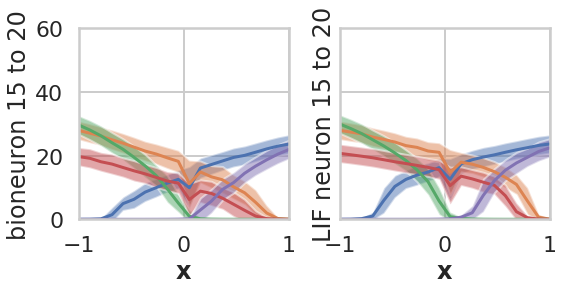

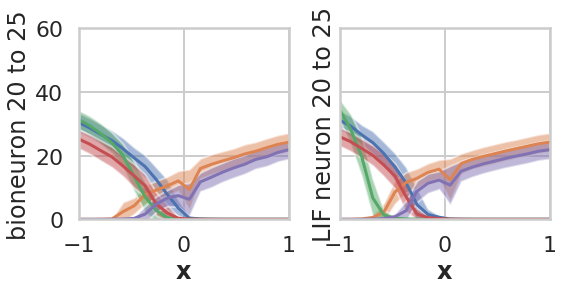

...

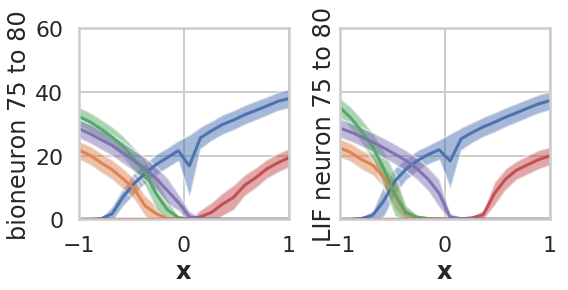

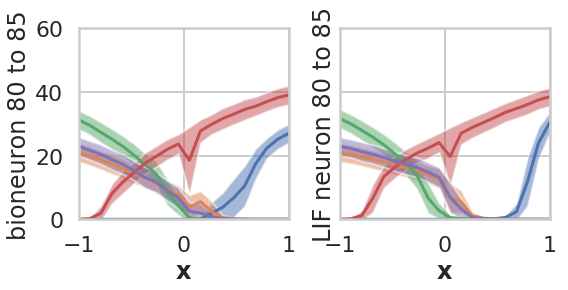

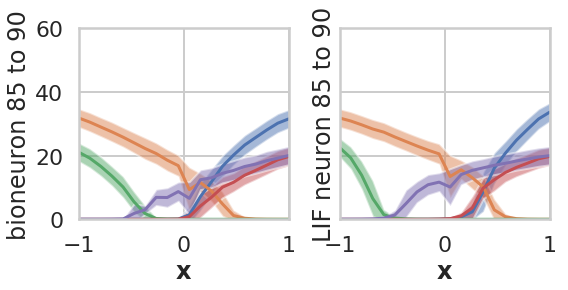

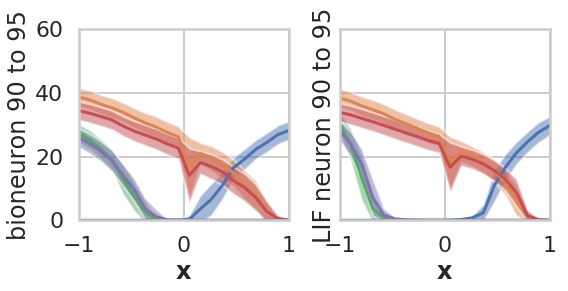

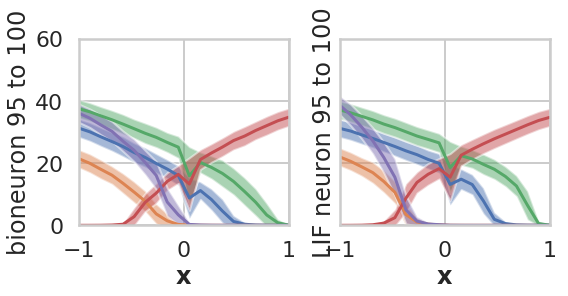

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

supervised simulation


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

least-squares optimization of recurrent filter and/or decoders


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:213: UserWarning: Synapse ((num=[ 1000. -1000.], den=[1. 0.], analog=False)) has extra delay due to passthrough (https://github.com/nengo/nengo/issues/938).
  "(https://github.com/nengo/nengo/issues/938)." % sys)


taus attempt 0, nonzero d 100, tau=[0.16056]: 


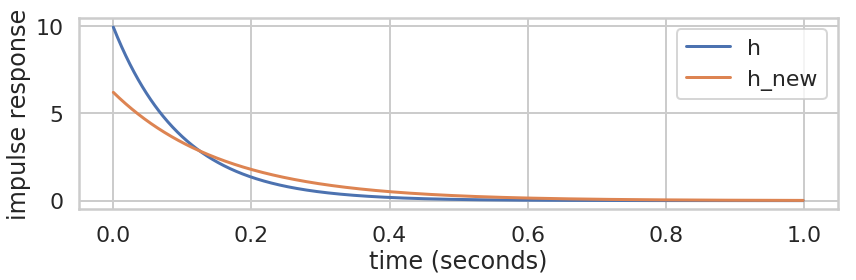

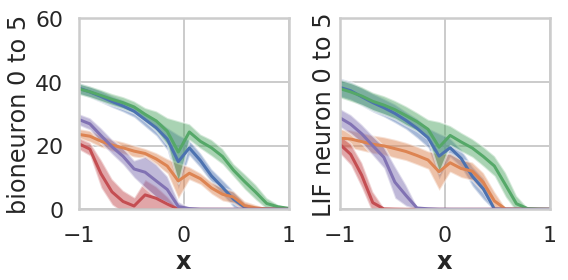

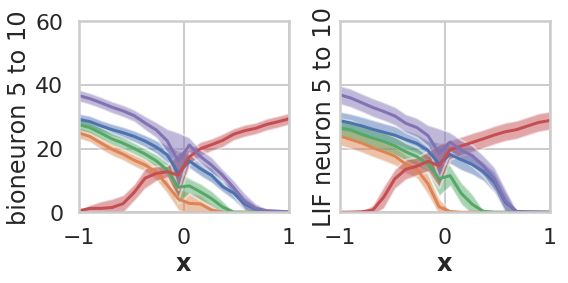

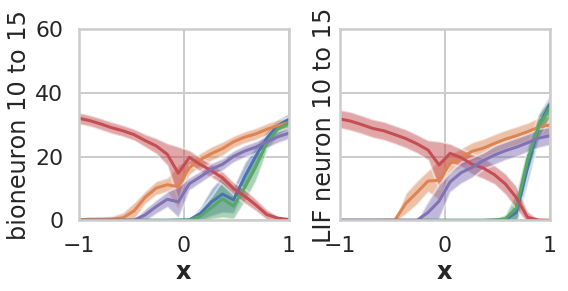

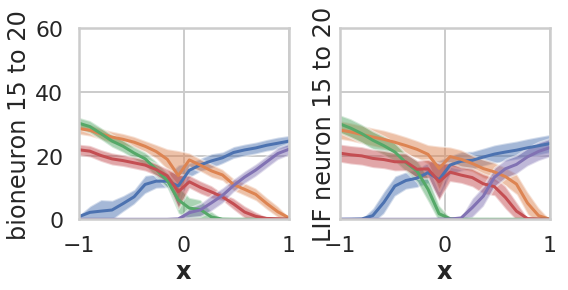

...

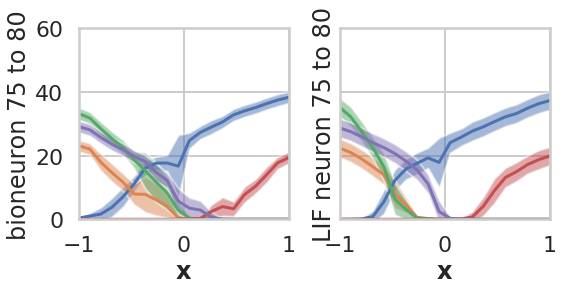

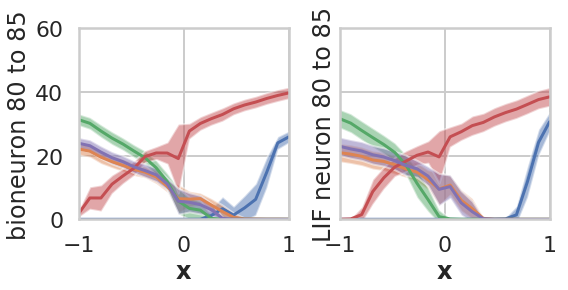

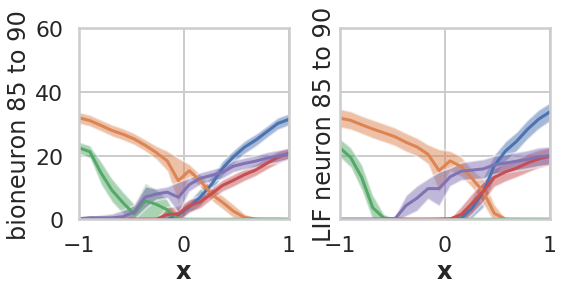

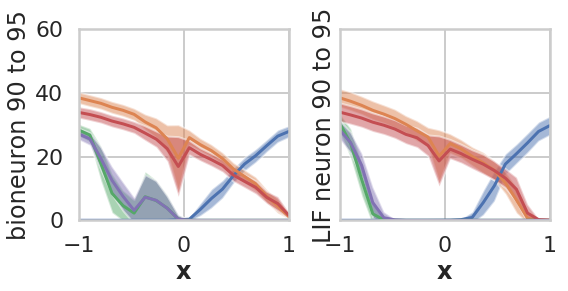

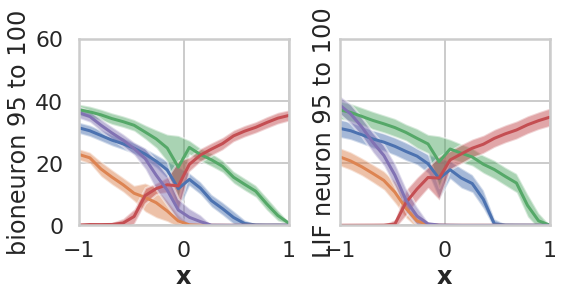

unsupervised simulation


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)
/home/pduggins/nengo/nengo/utils/numpy.py:79: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  v = a[inds]


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

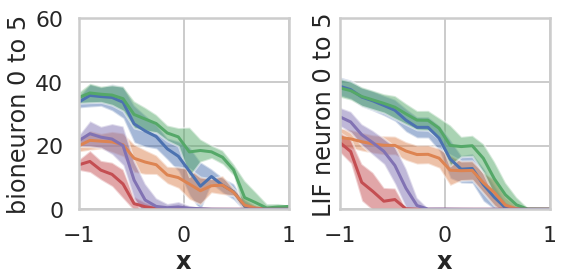

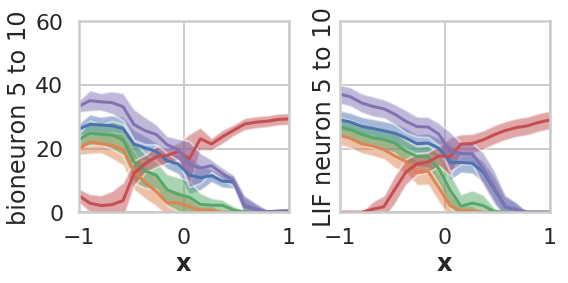

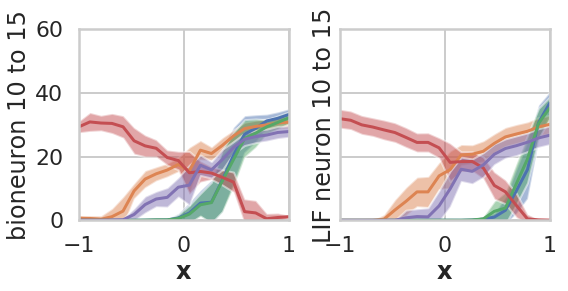

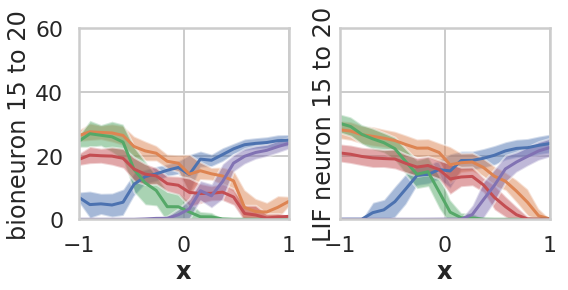

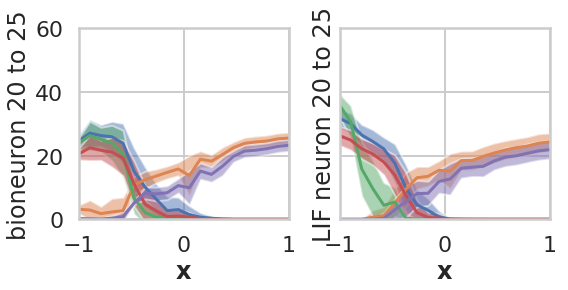

...

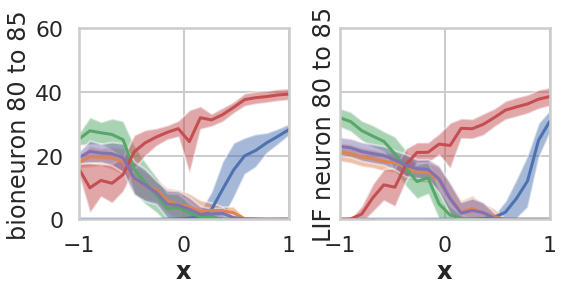

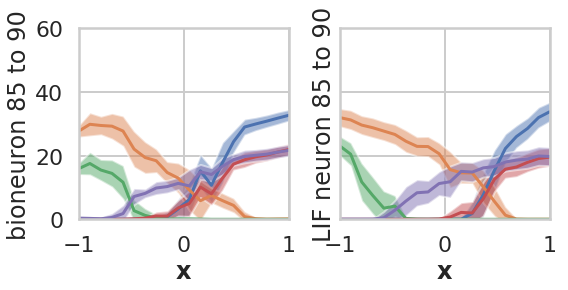

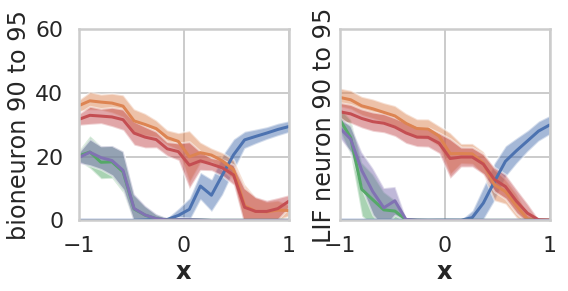

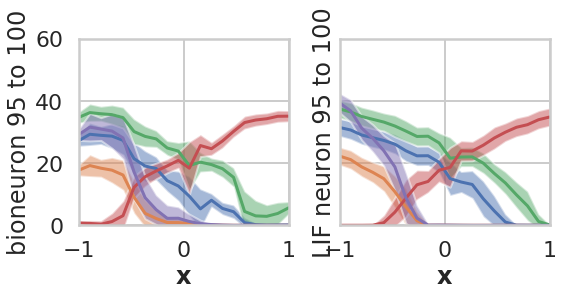

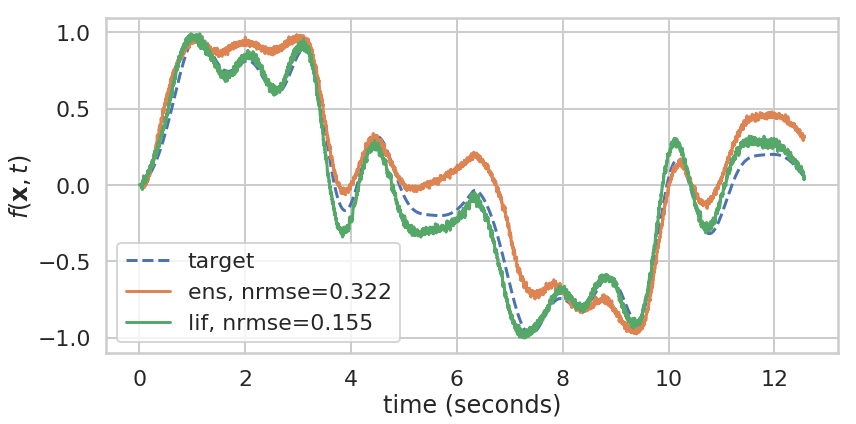

least-squares optimization of recurrent filter and/or decoders


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:213: UserWarning: Synapse ((num=[ 1000. -1000.], den=[1. 0.], analog=False)) has extra delay due to passthrough (https://github.com/nengo/nengo/issues/938).
  "(https://github.com/nengo/nengo/issues/938)." % sys)
/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:213: UserWarning: Synapse ((A=[[-0.]], B=[[1.]], C=[[-1000.]], D=[[1000.]], analog=False)) has extra delay due to passthrough (https://github.com/nengo/nengo/issues/938).
  "(https://github.com/nengo/nengo/issues/938)." % sys)


taus attempt 0, nonzero d 100, tau=[ 0.16511 -0.00093]: 
taus attempt 1, nonzero d 100, tau=[1.68953e-01 7.17579e-05]: 


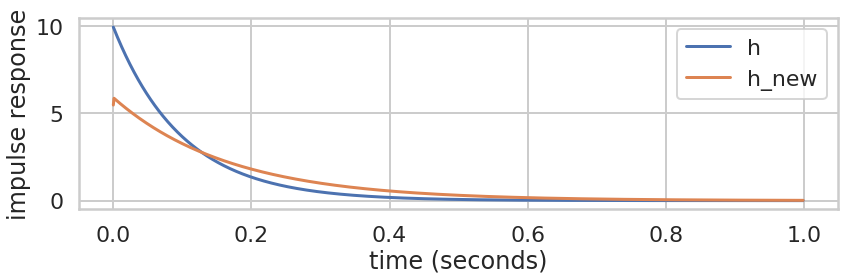

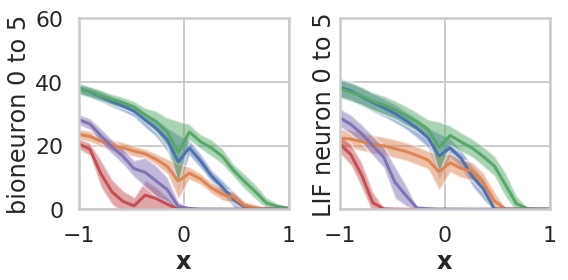

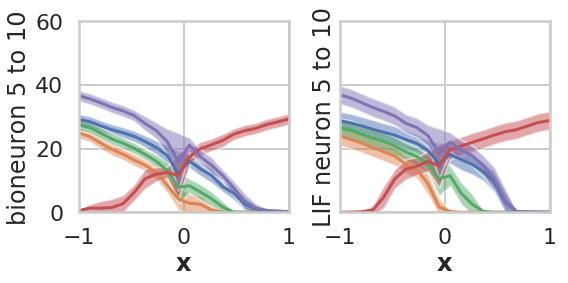

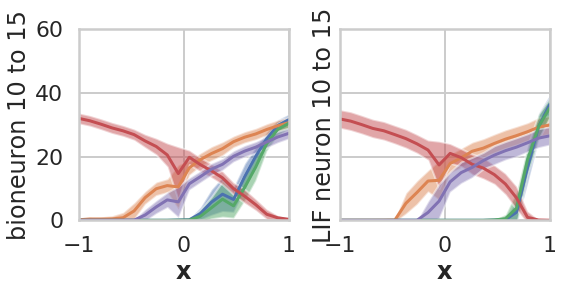

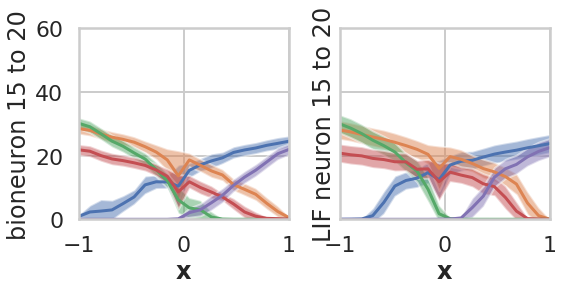

...

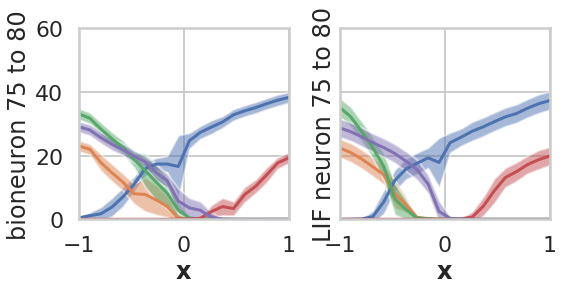

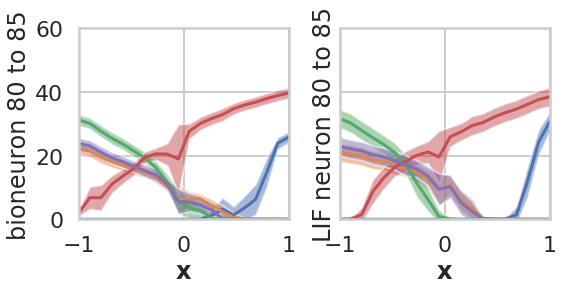

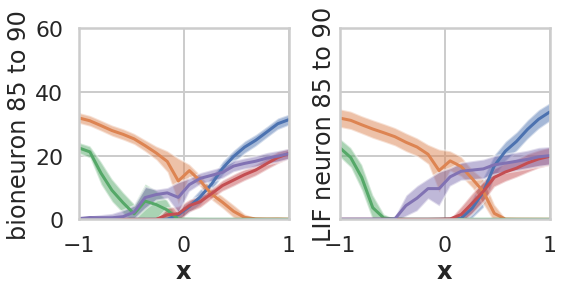

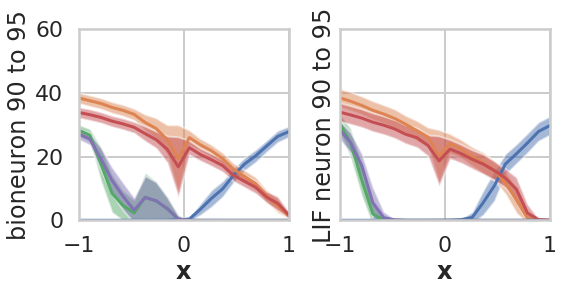

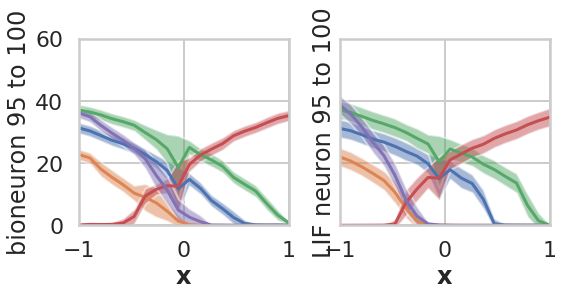

unsupervised simulation


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

/home/pduggins/nengo/nengo/utils/numpy.py:79: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  v = a[inds]


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

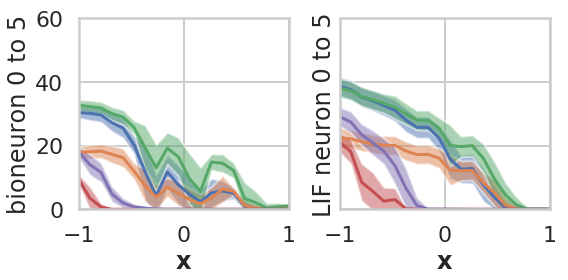

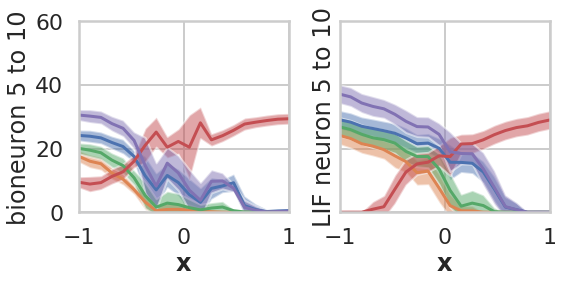

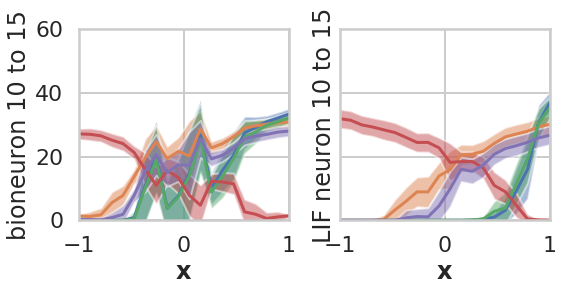

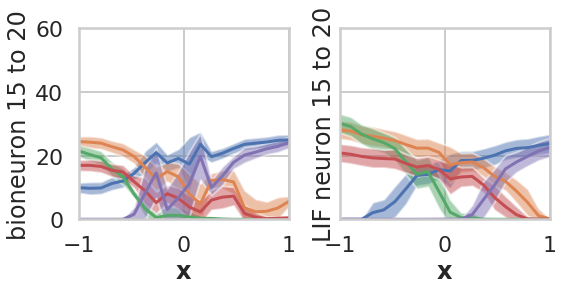

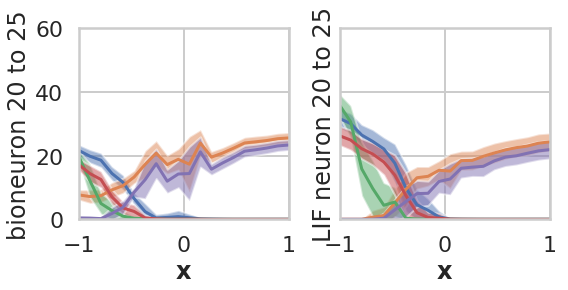

...

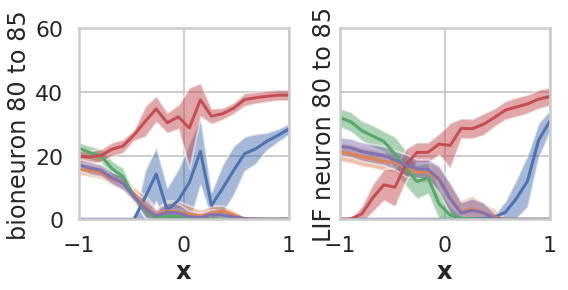

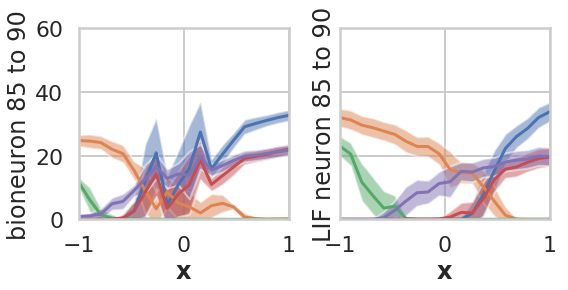

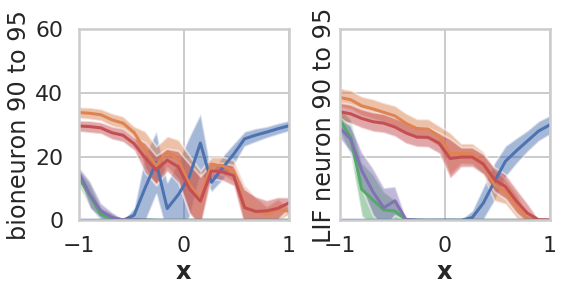

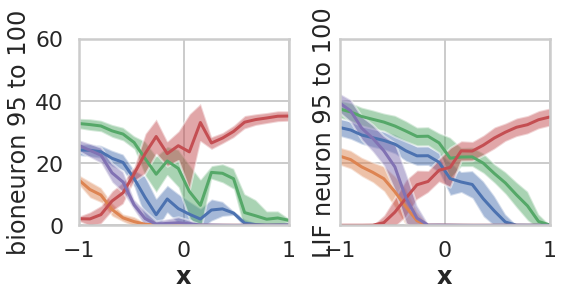

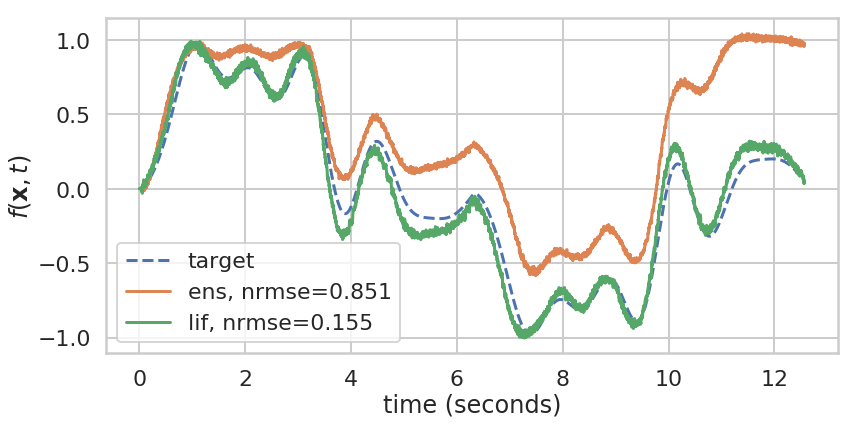

In [9]:
t = 4*np.pi
n_neurons = 100
neuron_type = DurstewitzNeuron()
max_rates = Uniform(20, 40)
intercepts = Uniform(-0.8, 0.8)
dt = 0.001
tau = 0.1
seed = 0
attempts = 10
reg = 1e-1
# delta_gain=1e-4, delta_bias=1e-5

d = np.zeros((n_neurons, 1))
h = Lowpass(tau)

print("optimizing gain and bias")
data_train = go(n_neurons, neuron_type, 1e-1, d, h, max_rates, intercepts,
    dt=dt, supv=1, seed=seed, reg=reg, attempts=attempts, freq=1e2, opt=True)

y_max = max_rates.high*1.5
gain_bias_dict = data_train['gain_bias_dict']

print("supervised simulation")
data_train = go(n_neurons, neuron_type, t, d, h, max_rates, intercepts,
    dt=dt, supv=1, seed=seed, reg=reg, gain_bias_dict=gain_bias_dict)

optimize_h = True
lambda_c = 1e-1
lambda_d = 1e-1
order = 1

print("least-squares optimization of recurrent filter and/or decoders")
h_new, d_new = update_h(data_train['stim'], data_train['tar'], data_train['spk'],
    lambda_c=lambda_c, lambda_d=lambda_d, order=order, dt=dt)

plot_filter(h, h_new)
plot_tuning(h.filt(data_train['tar'], dt=dt),
    h_new.filt(data_train['spk'], dt=dt),
    h.filt(data_train['spk_lif'], dt=dt),
    y_max=y_max, neurons_per_plot=5)

print("unsupervised simulation")
seed = 1
data_test = go(n_neurons, neuron_type, t, d_new, h_new,
    max_rates, intercepts, dt=dt, supv=0, seed=seed, reg=reg, gain_bias_dict=gain_bias_dict)

plot_tuning(h.filt(data_test['tar'], dt=dt),
    h_new.filt(data_test['spk'], dt=dt),
    h.filt(data_test['spk_lif'], dt=dt),
    y_max=y_max, neurons_per_plot=5)
xhat = np.dot(h_new.filt(data_test['spk'], dt=dt), d_new)
plot_estimate(data_test['times'], h.filt(data_test['tar'], dt=dt), xhat, data_test['x_lif'])

optimize_h = True
lambda_c = 1e-1
lambda_d = 1e-1
order = 2

print("least-squares optimization of recurrent filter and/or decoders")
h_new, d_new = update_h(data_train['stim'], data_train['tar'], data_train['spk'],
    lambda_c=lambda_c, lambda_d=lambda_d, order=order, dt=dt)

plot_filter(h, h_new)
plot_tuning(h.filt(data_train['tar'], dt=dt),
    h_new.filt(data_train['spk'], dt=dt),
    h.filt(data_train['spk_lif'], dt=dt),
    y_max=y_max, neurons_per_plot=5)

print("unsupervised simulation")
seed = 1
data_test = go(n_neurons, neuron_type, t, d_new, h_new,
    max_rates, intercepts, dt=dt, supv=0, seed=seed, reg=reg, gain_bias_dict=gain_bias_dict)

plot_tuning(h.filt(data_test['tar'], dt=dt),
    h_new.filt(data_test['spk'], dt=dt),
    h.filt(data_test['spk_lif'], dt=dt),
    y_max=y_max, neurons_per_plot=5)
xhat = np.dot(h_new.filt(data_test['spk'], dt=dt), d_new)
plot_estimate(data_test['times'], h.filt(data_test['tar'], dt=dt), xhat, data_test['x_lif'])

## data collection

In [20]:
def run_trial_type(t=10, n_neurons=100, dt=0.000025, tau=0.1, seed=0, n_trials=10, 
        max_rates=Uniform(20, 20), intercepts=Uniform(-1, 1), gain_bias_dict=dict(),
        optimize_h=False, attempts=5, lambda_c=1e0, lambda_d=1e0, order=1, reg=1e-2, pt=False, pe=False,
        neuron_types=[
            nengo.LIF(), AdaptiveLIFT(tau_adapt=0.1, inc_adapt=0.1), WilsonEuler(), DurstewitzNeuron()]):
    
#     nt_names = [str(nt) for nt in neuron_types]
    nt_names = ['LIF', 'ALIF', 'Wilson', 'Durstewitz']
    nrmses = np.zeros((len(neuron_types), n_trials))
    
    for nt, neuron_type in enumerate(neuron_types):

        d = np.zeros((n_neurons, 1))
        h = Lowpass(tau)

        print("supervised simulation")
        data_train = go(n_neurons, neuron_type, t, d, h, max_rates, intercepts,
            supv=1, dt=dt, seed=seed, reg=reg, attempts=attempts, opt=isinstance(neuron_type, DurstewitzNeuron))

        y_max = max_rates.high*1.5
        gain_bias_dict = data_train['gain_bias_dict']
        if type(neuron_type) is DurstewitzNeuron:
            max_rates = data_train['max_rates']
            intercepts = data_train['intercepts']

        print("least-squares optimization of recurrent filter and/or decoders")
        if optimize_h:
            h_new, d_new = update_h(data_train['stim'], data_train['tar'], data_train['spk'],
                lambda_c=lambda_c, lambda_d=lambda_d, order=order, dt=dt)
        else:
            h_new = h
            d_new = update_d(data_train['tar'], data_train['spk'], h, dt=dt)

        plot_filter(h, h_new)

        print("unsupervised simulation")
        seed_trial = seed
        for trial in range(n_trials):
            print("trial %s" %trial)
            seed_trial += 1
            data_test = go(n_neurons, neuron_type, t, d_new, h_new, max_rates, intercepts,
                supv=0, dt=dt, seed=seed_trial, reg=reg, gain_bias_dict=gain_bias_dict)
            xhat = np.dot(h_new.filt(data_test['spk']), d_new)
            target = h.filt(data_test['tar'])
            if pt:
                plot_tuning(h.filt(data_test['tar']), h_new.filt(data_test['spk']), h.filt(data_test['spk_lif']),
                    y_max=y_max, neurons_per_plot=5)
            if pe:
                plot_estimate(data_test['times'], h.filt(data_test['tar']), xhat, data_test['x_lif'])
            nrmses[nt, trial] = nrmse(xhat, target=target)
            
    fig, ax = plt.subplots(1, 1, figsize=(8, 6))
    sns.barplot(data=nrmses.T)
    ax.set(ylabel='NRMSE')
    plt.xticks(np.arange(len(nt_names)), tuple(nt_names), rotation=0)
    plt.show()

    return nrmses

supervised simulation


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)
/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

least-squares optimization of recurrent filter and/or decoders


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:213: UserWarning: Synapse ((num=[ 1000. -1000.], den=[1. 0.], analog=False)) has extra delay due to passthrough (https://github.com/nengo/nengo/issues/938).
  "(https://github.com/nengo/nengo/issues/938)." % sys)


taus attempt 0, nonzero d 100, tau=[0.14524]: 


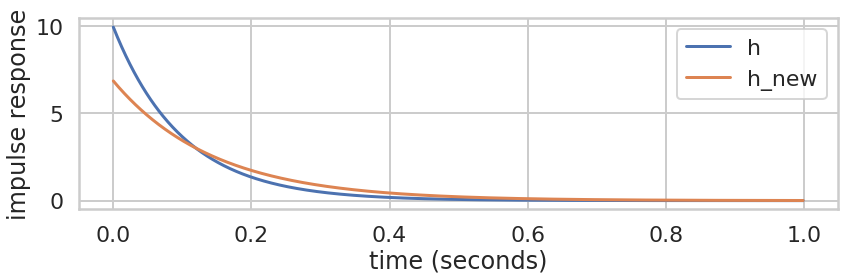

unsupervised simulation
trial 0


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)
/home/pduggins/nengo/nengo/utils/numpy.py:79: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  v = a[inds]


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

trial 1


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)
/home/pduggins/nengo/nengo/utils/numpy.py:79: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  v = a[inds]


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

trial 2


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)
/home/pduggins/nengo/nengo/utils/numpy.py:79: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  v = a[inds]


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

trial 3


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)
/home/pduggins/nengo/nengo/utils/numpy.py:79: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  v = a[inds]


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

trial 4


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)
/home/pduggins/nengo/nengo/utils/numpy.py:79: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  v = a[inds]


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

supervised simulation


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

least-squares optimization of recurrent filter and/or decoders


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:213: UserWarning: Synapse ((num=[ 1000. -1000.], den=[1. 0.], analog=False)) has extra delay due to passthrough (https://github.com/nengo/nengo/issues/938).
  "(https://github.com/nengo/nengo/issues/938)." % sys)


taus attempt 0, nonzero d 100, tau=[0.20807]: 


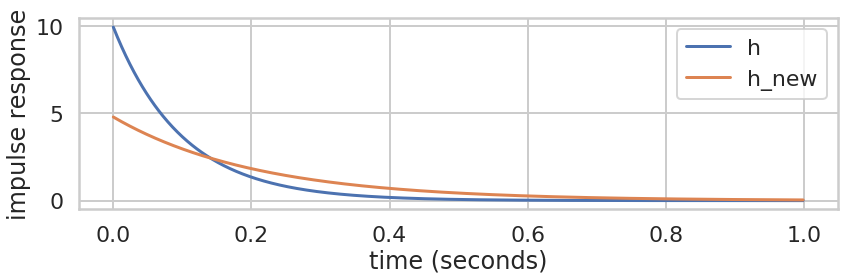

unsupervised simulation
trial 0


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)
/home/pduggins/nengo/nengo/utils/numpy.py:79: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  v = a[inds]


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

trial 1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)
/home/pduggins/nengo/nengo/utils/numpy.py:79: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  v = a[inds]


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

trial 2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)
/home/pduggins/nengo/nengo/utils/numpy.py:79: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  v = a[inds]


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

trial 3


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)
/home/pduggins/nengo/nengo/utils/numpy.py:79: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  v = a[inds]


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

trial 4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)
/home/pduggins/nengo/nengo/utils/numpy.py:79: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  v = a[inds]


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


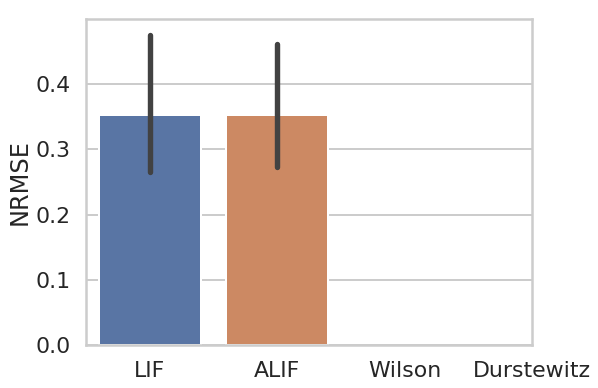

In [15]:
nrmses = run_trial_type(dt=0.001, n_trials=5, optimize_h=True,
    neuron_types=[nengo.LIF(), AdaptiveLIFT(tau_adapt=0.1, inc_adapt=0.1)])

supervised simulation


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)
/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

least-squares optimization of recurrent filter and/or decoders


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:213: UserWarning: Synapse ((num=[ 40000. -40000.], den=[1. 0.], analog=False)) has extra delay due to passthrough (https://github.com/nengo/nengo/issues/938).
  "(https://github.com/nengo/nengo/issues/938)." % sys)


taus attempt 0, nonzero d 100, tau=[0.14007]: 


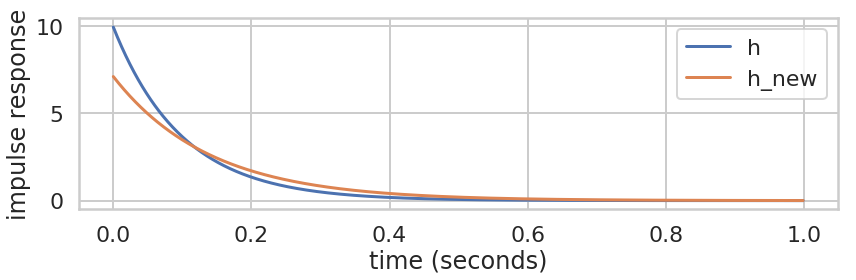

unsupervised simulation
trial 0


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)
/home/pduggins/nengo/nengo/utils/numpy.py:79: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  v = a[inds]


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

trial 1


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)
/home/pduggins/nengo/nengo/utils/numpy.py:79: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  v = a[inds]


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

trial 2


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)
/home/pduggins/nengo/nengo/utils/numpy.py:79: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  v = a[inds]


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

trial 3


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)
/home/pduggins/nengo/nengo/utils/numpy.py:79: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  v = a[inds]


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

trial 4


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)
/home/pduggins/nengo/nengo/utils/numpy.py:79: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  v = a[inds]


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

supervised simulation


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

least-squares optimization of recurrent filter and/or decoders


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:213: UserWarning: Synapse ((num=[ 40000. -40000.], den=[1. 0.], analog=False)) has extra delay due to passthrough (https://github.com/nengo/nengo/issues/938).
  "(https://github.com/nengo/nengo/issues/938)." % sys)


taus attempt 0, nonzero d 100, tau=[0.19848]: 


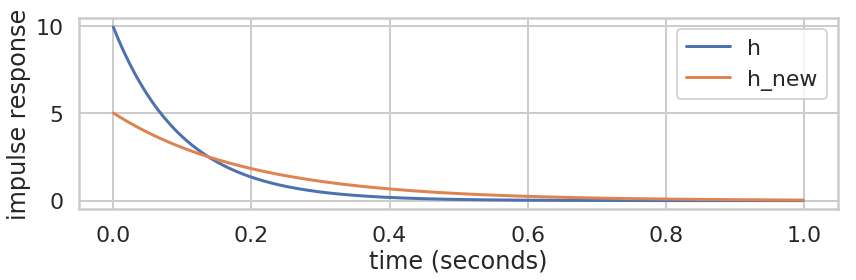

unsupervised simulation
trial 0


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)
/home/pduggins/nengo/nengo/utils/numpy.py:79: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  v = a[inds]


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

trial 1


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)
/home/pduggins/nengo/nengo/utils/numpy.py:79: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  v = a[inds]


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

trial 2


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)
/home/pduggins/nengo/nengo/utils/numpy.py:79: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  v = a[inds]


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

trial 3


/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)
/home/pduggins/nengo/nengo/utils/numpy.py:79: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  v = a[inds]


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

trial 4


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/nengolib/signal/system.py:197: UserWarning: y0 (None!=0) does not properly initialize the system; see Nengo issue #1124.
  "Nengo issue #1124." % y0, UserWarning)
/home/pduggins/nengo/nengo/utils/numpy.py:79: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  v = a[inds]


HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc.set('progress', 'progress_bar', 'nengo.utils.progress.TerminalProgressBar')`.

/home/pduggins/.virtualenvs/nbn/lib/python3.6/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


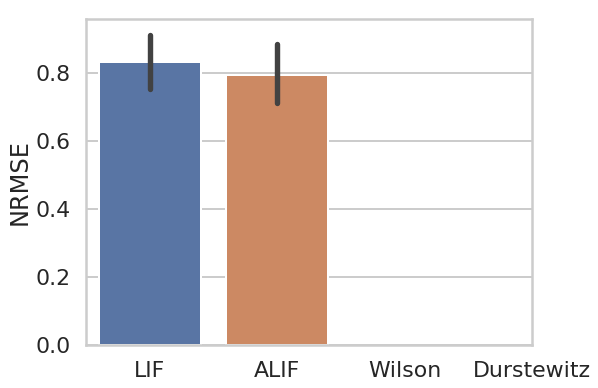

In [21]:
nrmses = run_trial_type(dt=0.000025, n_trials=5, optimize_h=True, order=1,
    neuron_types=[nengo.LIF(), AdaptiveLIFT(tau_adapt=0.1, inc_adapt=0.1)])

In [ ]:
nrmses = run_trial_type(order=1)

In [ ]:
nrmses = run_trial_type(order=2)